In [1]:
import os
from IPython.display import display, Image
import random
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import layers, models
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import pickle

LOAD DATA


In [2]:
data=tf.keras.utils.image_dataset_from_directory('./All_images/training')

Found 1290 files belonging to 2 classes.


In [3]:
train_data_dir = './All_images/training'

# Set the desired image size (e.g., 128x128)
desired_image_size = (256, 256)

# Use image_dataset_from_directory to create a labeled dataset
data = tf.keras.utils.image_dataset_from_directory(
    train_data_dir,
    batch_size=32,               # Adjust batch size as needed
    image_size=desired_image_size,  # Specify the desired image size
    shuffle=True,                # Shuffle the dataset
    seed=123                     # Set seed for reproducibility
)

Found 1290 files belonging to 2 classes.


In [4]:
data

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

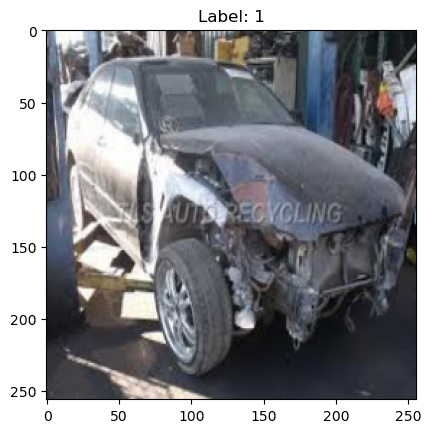

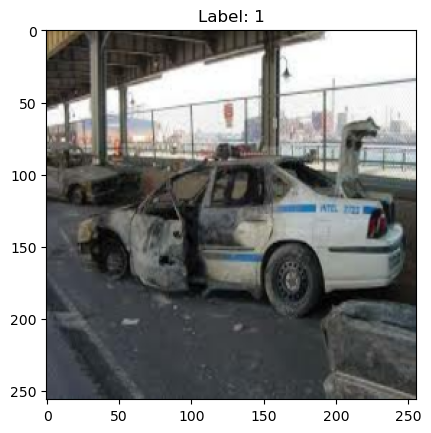

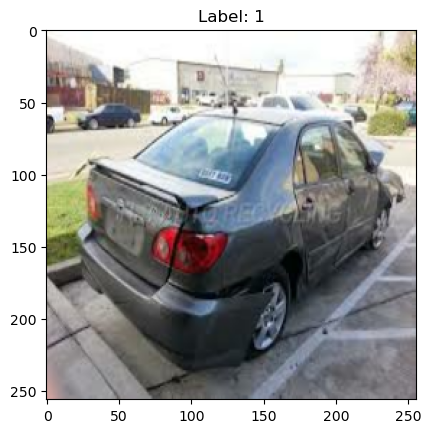

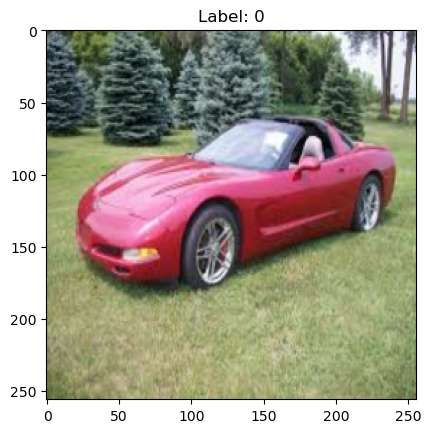

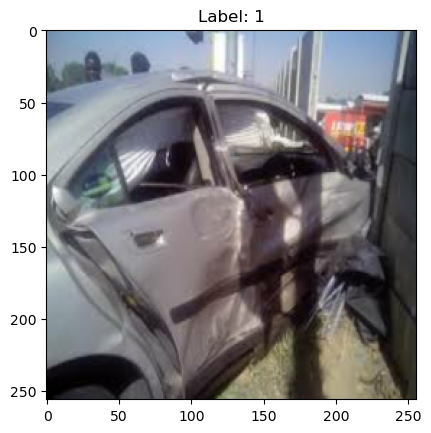

...

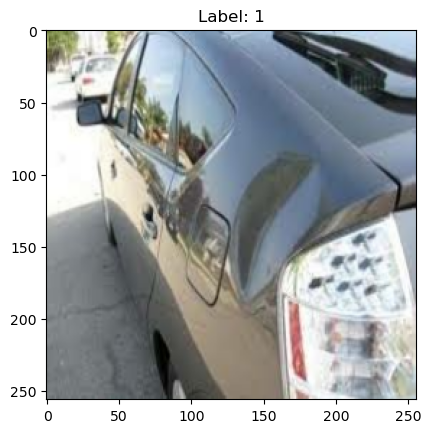

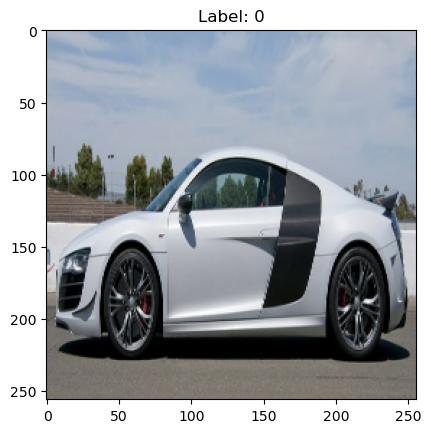

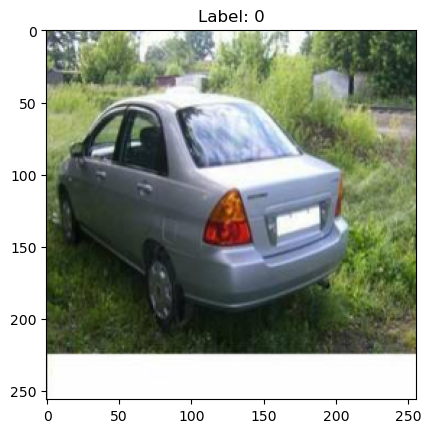

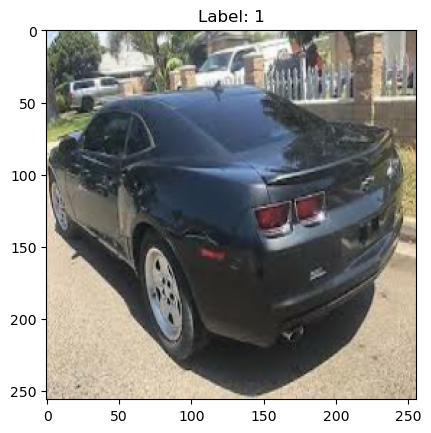

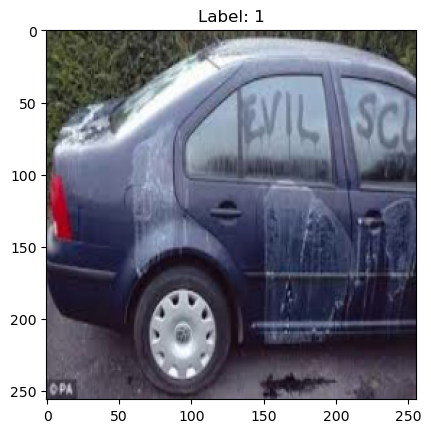

In [5]:
# for element in data:
#     images, labels = element
#     for i in range(len(images)):
#         # Assuming you are using matplotlib to display images
#         plt.imshow(images[i].numpy().astype("uint8"))
#         plt.title(f"Label: {labels[i].numpy()}")
#         plt.show()

# Counter to keep track of the number of images printed
# Define a dictionary to keep track of the number of images shown for each class
num_images_shown_per_class = {}

# Iterate through the dataset and print only the first 10 images from each class
for images, labels in data:
    for i in range(len(images)):
        label = labels[i].numpy()
        
        # Check if the current label exists in the dictionary
        if label not in num_images_shown_per_class:
            num_images_shown_per_class[label] = 0
        
        # Display the image using matplotlib if fewer than 10 images have been shown for this class
        if num_images_shown_per_class[label] < 10:
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(f"Label: {label}")
            plt.show()
            
            # Increment the counter for the current class
            num_images_shown_per_class[label] += 1
            
        # Check if 10 images have been shown for each class
        if all(count >= 10 for count in num_images_shown_per_class.values()):
            break
            
    # Check if 10 images have been shown for each class
    if all(count >= 10 for count in num_images_shown_per_class.values()):
        break



In [6]:
   #  print(f"Type of element: {type(element)}")
print(f"Type of images: {type(images)}")
print(f"Type of labels: {type(labels)}")

Type of images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Type of labels: <class 'tensorflow.python.framework.ops.EagerTensor'>


In [7]:
# Check the size of the images
image_size = data.element_spec[0].shape[1:3]
print("Image size:", image_size)

Image size: (256, 256)


In [8]:
data_iterator=data.as_numpy_iterator()
batch=data_iterator.next()
#image representative as numpy array
print(len(batch))
batch[0].shape
batch[1]

2


array([0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1,
       1, 0, 0, 0, 0, 1, 0, 0, 0, 0])

In [9]:
batch_size = batch[0].shape[0]
print("Batch size:", batch_size)

Batch size: 32


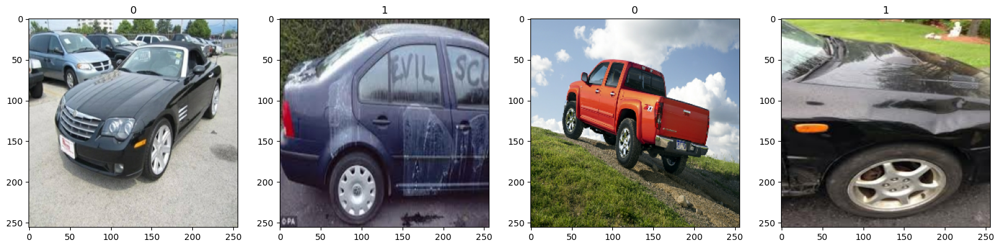

In [10]:
fig,ax=plt.subplots(ncols=4,figsize=(20,20))
for idx,img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

Pre_Process Data

In [11]:
data=data.map(lambda x,y: (x/255 ,y))

In [12]:
data.as_numpy_iterator().next()


(array([[[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],
 
         [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],
 
         [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
          ...,
          [0.00000000e+00, 0.00000000e+00, 0.0000

In [13]:
len(data) #represent batch size

41

In [14]:
train_size=int(len(data)*.7)-1
val_size=int(len(data)*.2)+1
test_size=int(len(data)*.1)+1

In [15]:
print(train_size,val_size,test_size)

27 9 5


In [16]:
train=data.take(train_size)
val=data.skip(train_size).take(val_size)
test=data.skip(train_size+val_size).take(test_size)

In [17]:
# #Assuming 4 classes (adjust as needed)
# num_classes = 5

# # Image size
# img_height, img_width = 256, 256

# model = models.Sequential([
#     layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(64, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Conv2D(128, (3, 3), activation='relu'),
#     layers.MaxPooling2D((2, 2)),
#     layers.Flatten(),
#     layers.Dense(256, activation='relu'),
#     layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using softmax activation
# ])
#Assuming 4 classes (adjust as needed)
num_classes = 2

# Image size
img_height, img_width = 256, 256

model = models.Sequential([
    layers.Conv2D(128, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(32, activation='relu'),
    layers.Dense(num_classes, activation='sigmoid')  # Multi-class classification, so using sigmoid activation
])

In [18]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 128)     3584      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 128)    0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 128)     147584    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 62, 62, 128)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 64)        73792     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 30, 30, 64)       0

In [19]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
# model.compile(optimizer='adam',
#               loss='binary_crossentropy',  # Use binary crossentropy for binary classification
#               metrics=['accuracy'])


TRAin model


In [20]:
logsdir='.\logs'

In [21]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir=logsdir)

In [22]:
hist=model.fit(train,epochs=7,validation_data=val,callbacks=[tensorboard_callback],batch_size=32)

Epoch 1/7
27/27 [==============================] - 17s 211ms/step - loss: 0.7896 - accuracy: 0.5544 - val_loss: 0.6471 - val_accuracy: 0.5486
Epoch 2/7
27/27 [==============================] - 6s 196ms/step - loss: 0.5953 - accuracy: 0.6354 - val_loss: 0.5623 - val_accuracy: 0.6840
Epoch 3/7
27/27 [==============================] - 6s 195ms/step - loss: 0.5327 - accuracy: 0.7176 - val_loss: 0.5349 - val_accuracy: 0.7014
Epoch 4/7
27/27 [==============================] - 6s 194ms/step - loss: 0.4189 - accuracy: 0.8009 - val_loss: 0.3826 - val_accuracy: 0.8542
Epoch 5/7
27/27 [==============================] - 6s 195ms/step - loss: 0.3774 - accuracy: 0.8449 - val_loss: 0.3864 - val_accuracy: 0.8438
Epoch 6/7
27/27 [==============================] - 6s 195ms/step - loss: 0.2591 - accuracy: 0.8854 - val_loss: 0.5876 - val_accuracy: 0.7326
Epoch 7/7
27/27 [==============================] - 5s 194ms/step - loss: 0.1913 - accuracy: 0.9271 - val_loss: 0.3422 - val_accuracy: 0.8715


In [23]:
hist.history

{'loss': [0.7895694375038147,
  0.5952799916267395,
  0.5326673984527588,
  0.41892358660697937,
  0.3773566484451294,
  0.2590732276439667,
  0.19127732515335083],
 'accuracy': [0.5543981194496155,
  0.6354166865348816,
  0.7175925970077515,
  0.8009259104728699,
  0.8449074029922485,
  0.8854166865348816,
  0.9270833134651184],
 'val_loss': [0.647059440612793,
  0.5622724294662476,
  0.5349444150924683,
  0.3826221227645874,
  0.38637182116508484,
  0.587586522102356,
  0.34221887588500977],
 'val_accuracy': [0.5486111044883728,
  0.6840277910232544,
  0.7013888955116272,
  0.8541666865348816,
  0.84375,
  0.7326388955116272,
  0.8715277910232544]}

PLOT Performance

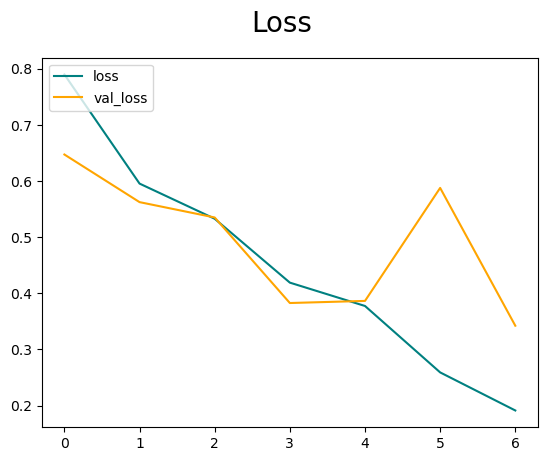

In [24]:
fig=plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc="upper left")
plt.show()

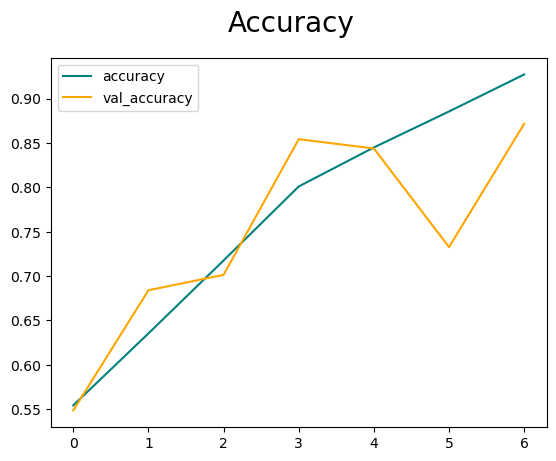

In [25]:
fig=plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc="upper left")
plt.show()

Evaluate Performance


In [26]:
#For confusion matrix
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns

true_labels = []
predicted_labels = []

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    yhat_classes = np.argmax(yhat, axis=1)
    true_labels.extend(y)
    predicted_labels.extend(yhat_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

1/1 [==============================] - 1s 635ms/step


Confusion Matrix:
[[57 14]
 [12 55]]


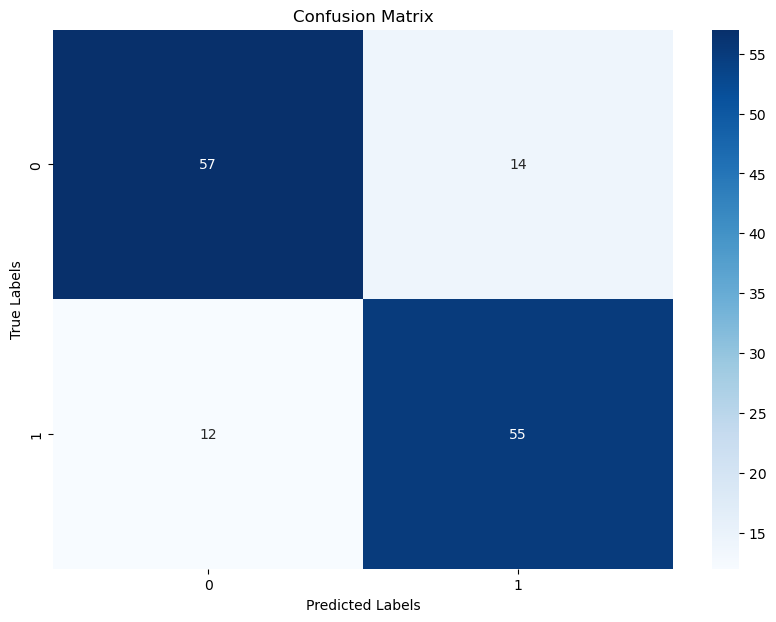

In [27]:
# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Print the confusion matrix
print("Confusion Matrix:")
print(cm)

# Plot the confusion matrix using Seaborn for better visualization
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [28]:
from tensorflow.keras.metrics import Precision,Recall,SparseCategoricalAccuracy,CategoricalAccuracy

In [29]:
pre=Precision()
re=Recall()
acc=CategoricalAccuracy()

In [30]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    print(y.shape)
    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)
    
    for actual, predicted in zip(y, yhat_classes):
        print(f"Actual: {actual}, Predicted: {predicted}")
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)


1/1 [==============================] - 0s 37ms/step
(32,)
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 1
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
1/1 [==============================] - 0s 40ms/step
(32,)
Actual: 1, Predicted: 1
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted

1/1 [==============================] - 0s 40ms/step
Actual: 0, Predicted: 0


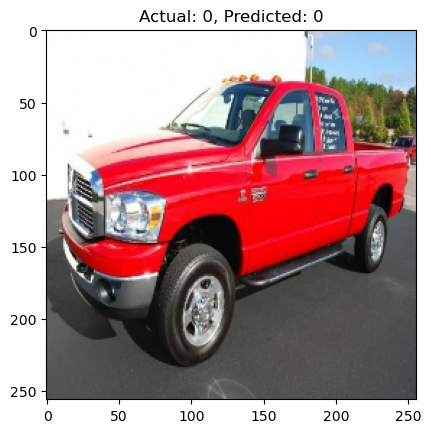

Actual: 1, Predicted: 1


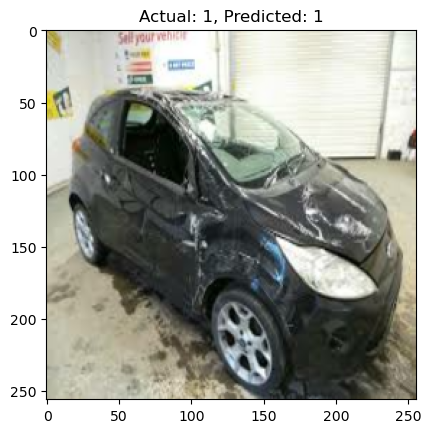

Actual: 1, Predicted: 1


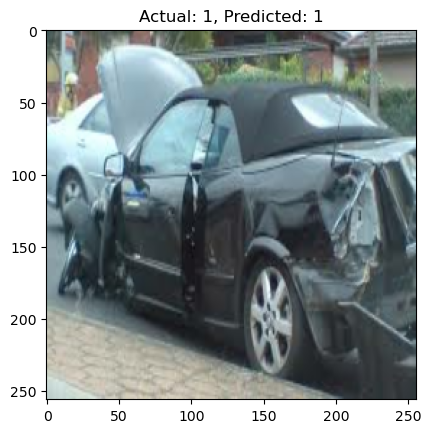

Actual: 0, Predicted: 0


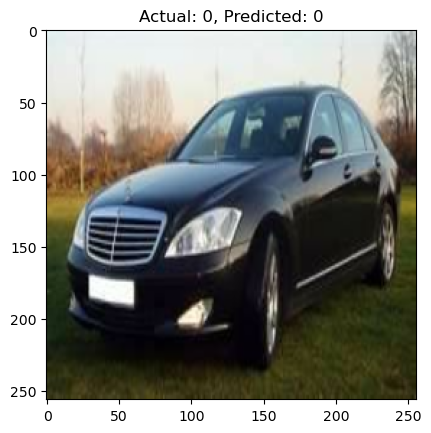

Actual: 1, Predicted: 0


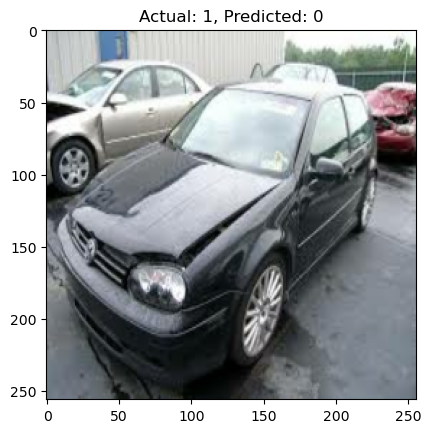

Actual: 1, Predicted: 1


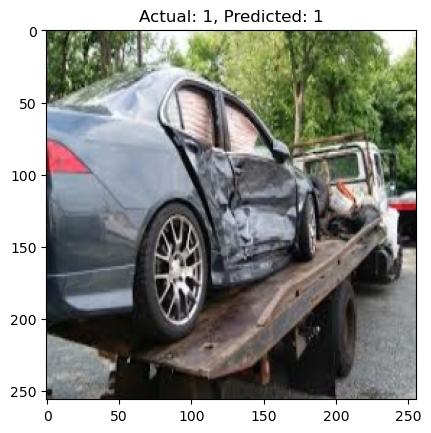

Actual: 1, Predicted: 1


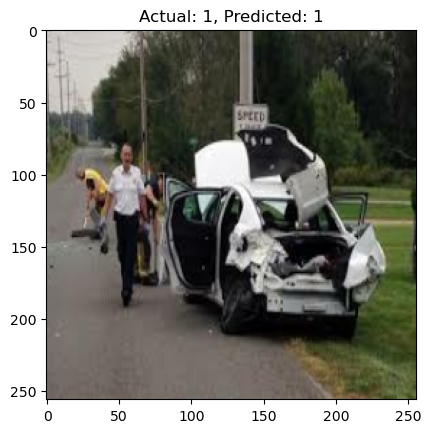

Actual: 1, Predicted: 1


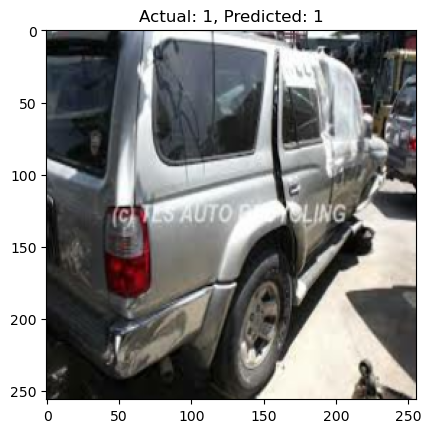

Actual: 0, Predicted: 0


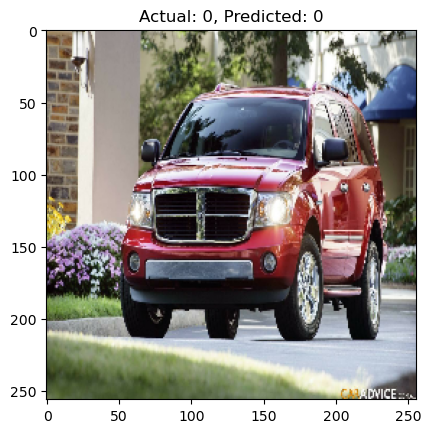

Actual: 0, Predicted: 0


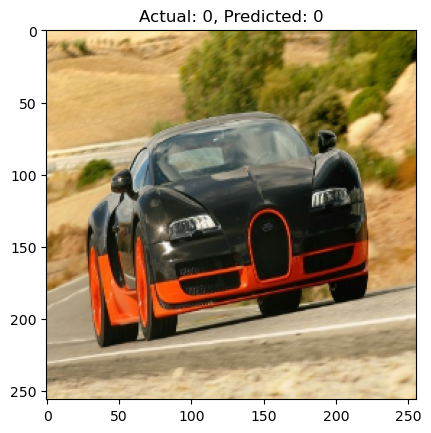

Actual: 0, Predicted: 0


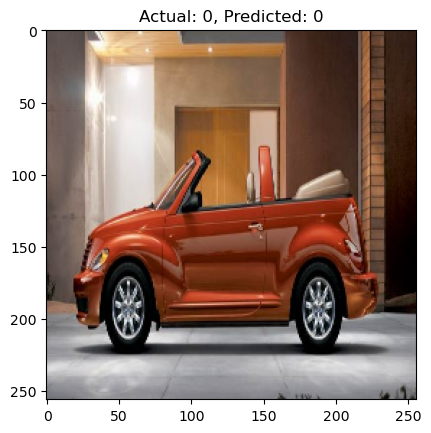

Actual: 1, Predicted: 0


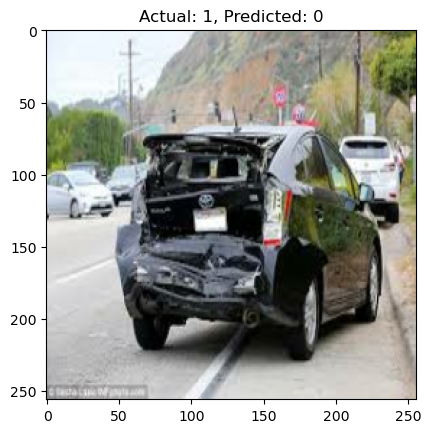

Actual: 1, Predicted: 1


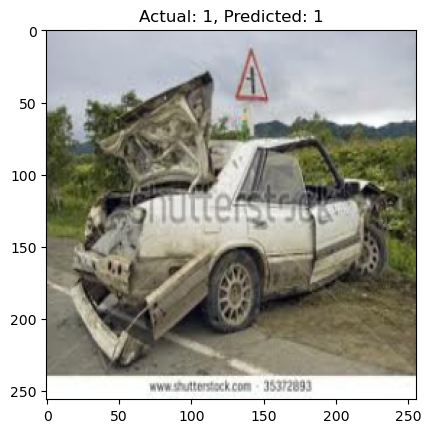

Actual: 1, Predicted: 0


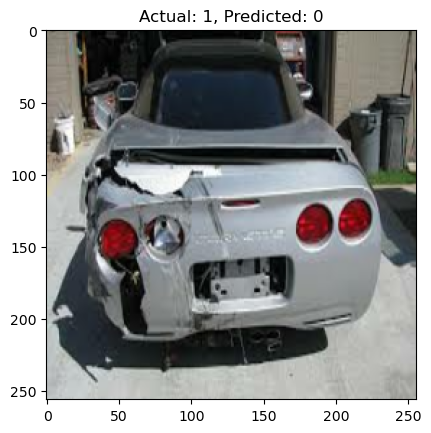

Actual: 1, Predicted: 0


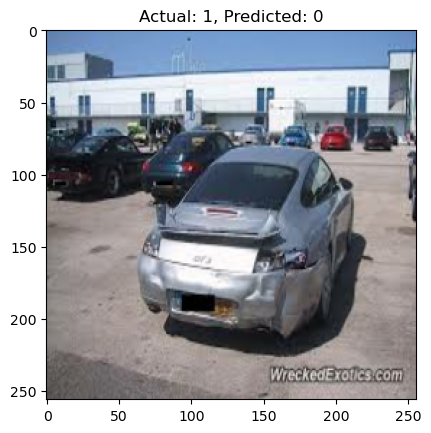

Actual: 1, Predicted: 1


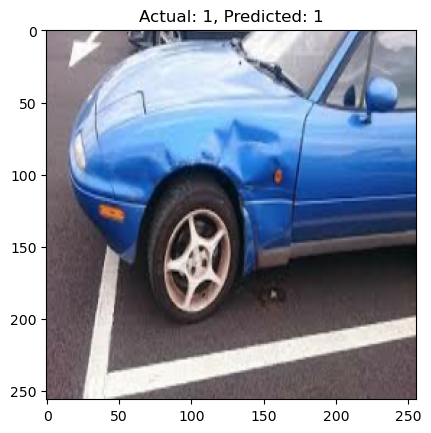

Actual: 0, Predicted: 0


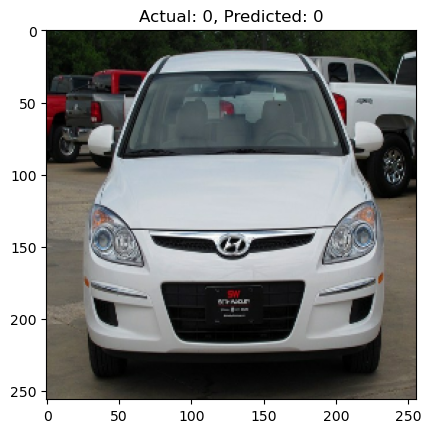

Actual: 1, Predicted: 1


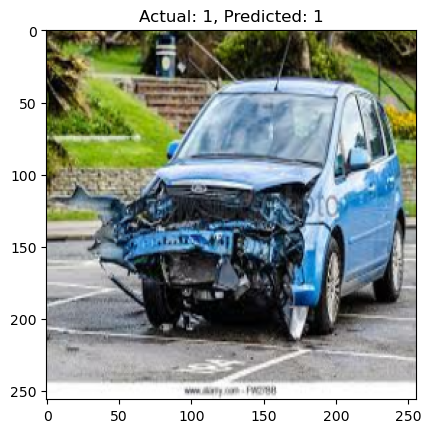

Actual: 0, Predicted: 0


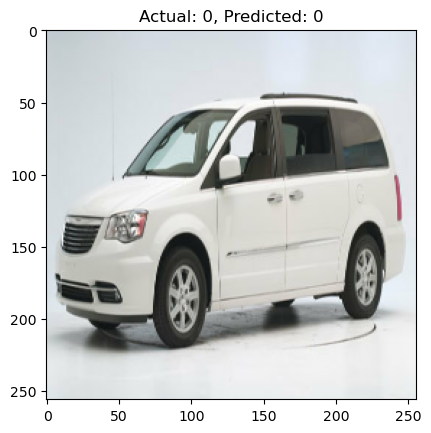

Actual: 0, Predicted: 1


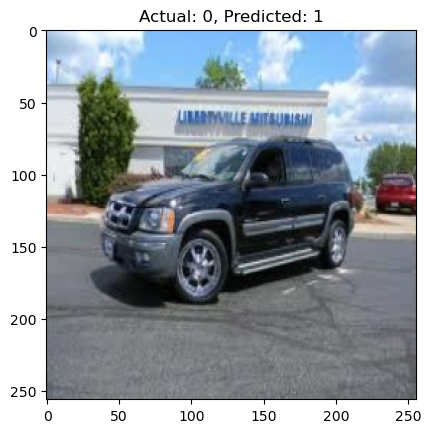

Actual: 0, Predicted: 0


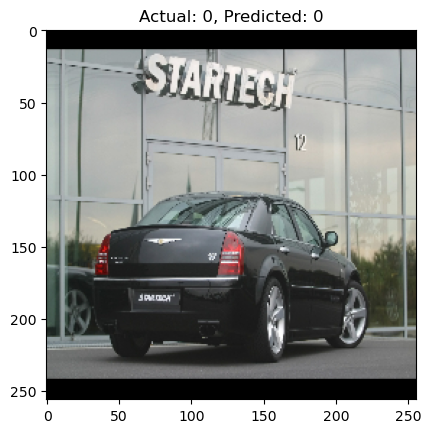

Actual: 0, Predicted: 0


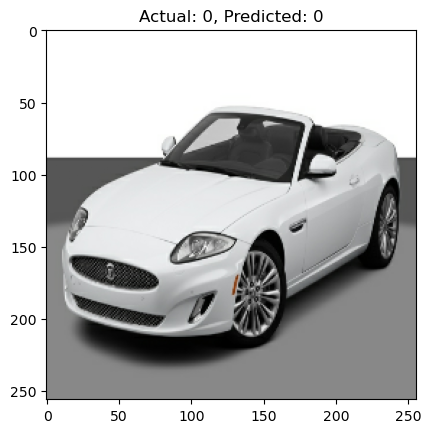

Actual: 1, Predicted: 0


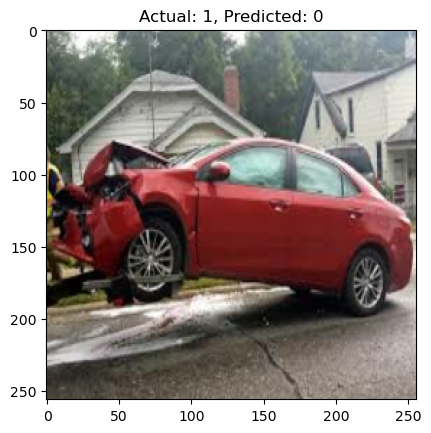

Actual: 0, Predicted: 0


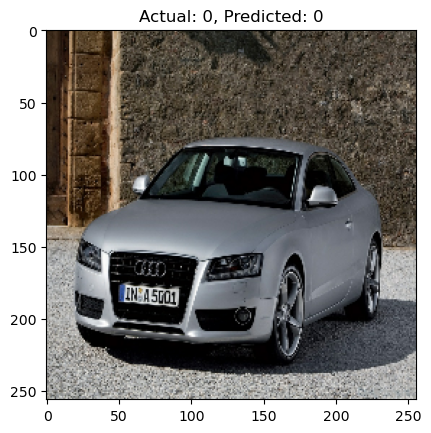

Actual: 0, Predicted: 0


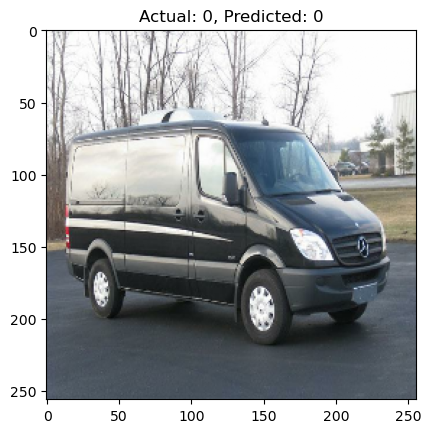

Actual: 1, Predicted: 1


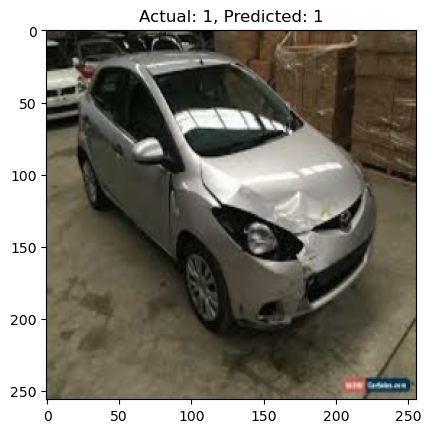

Actual: 0, Predicted: 0


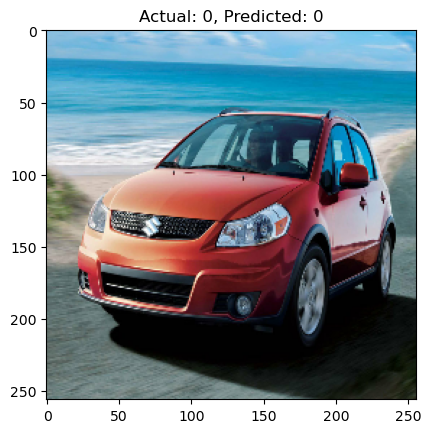

Actual: 0, Predicted: 0


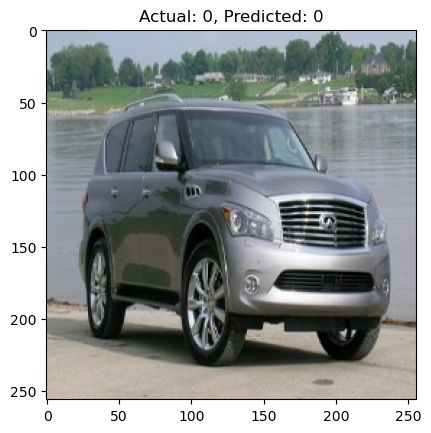

Actual: 1, Predicted: 1


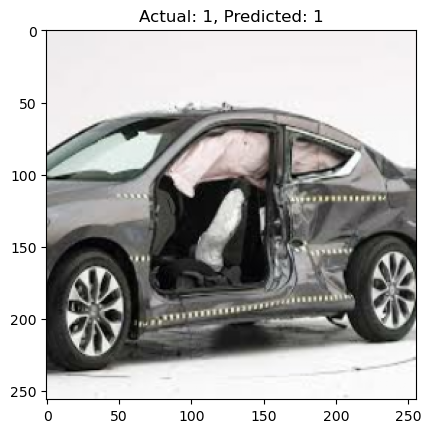

Actual: 1, Predicted: 1


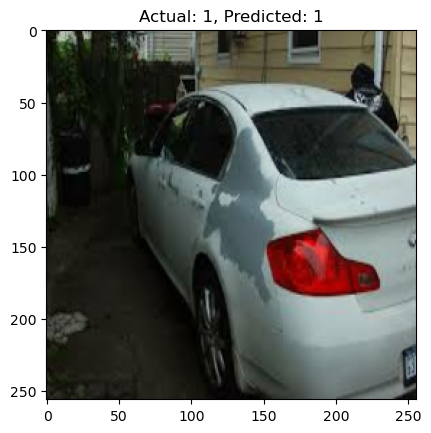

Actual: 1, Predicted: 1


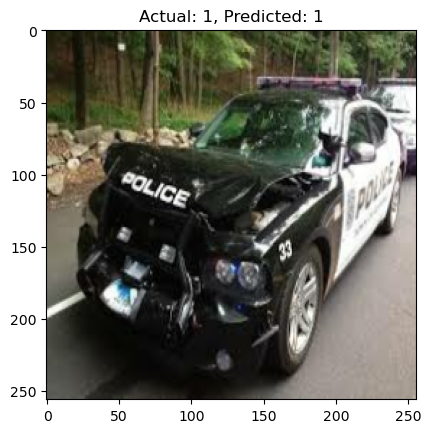

Actual: 0, Predicted: 1


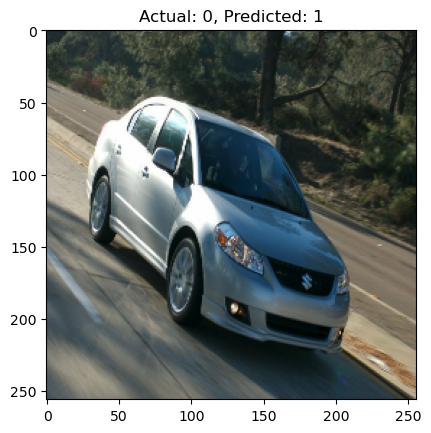

(32,) (32,)
1/1 [==============================] - 0s 47ms/step
Actual: 1, Predicted: 1


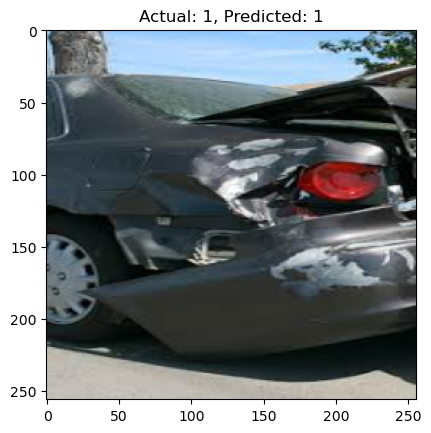

Actual: 1, Predicted: 1


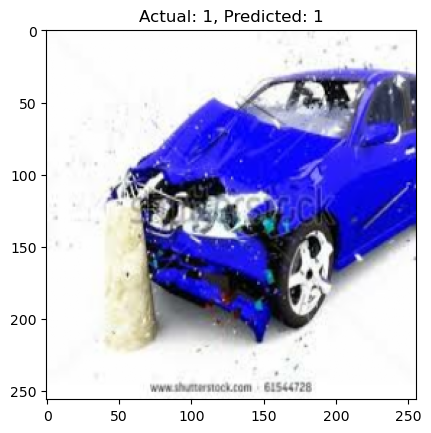

Actual: 1, Predicted: 1


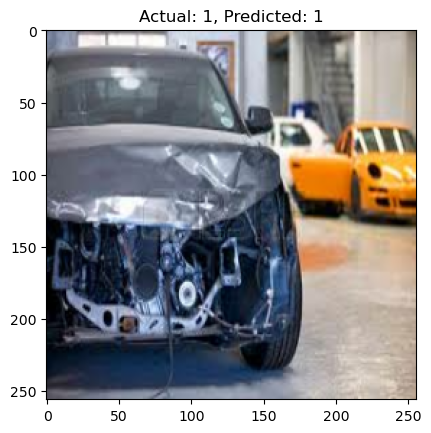

Actual: 1, Predicted: 1


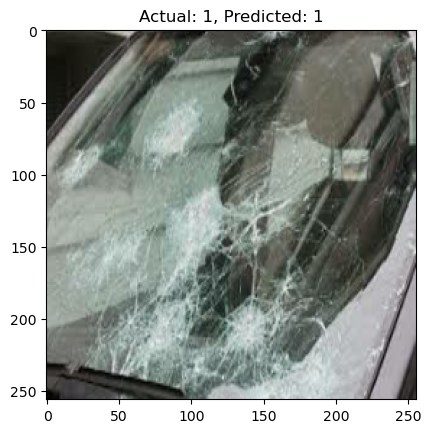

Actual: 0, Predicted: 0


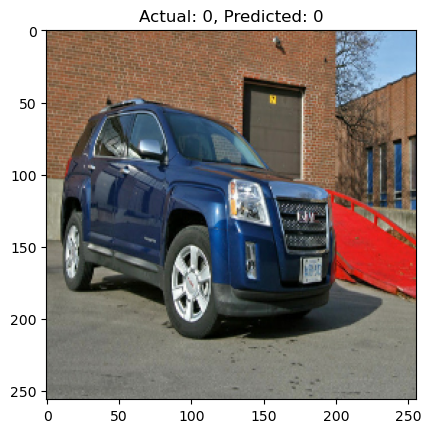

Actual: 0, Predicted: 1


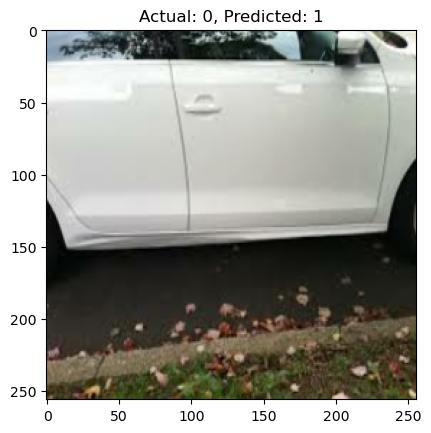

Actual: 0, Predicted: 0


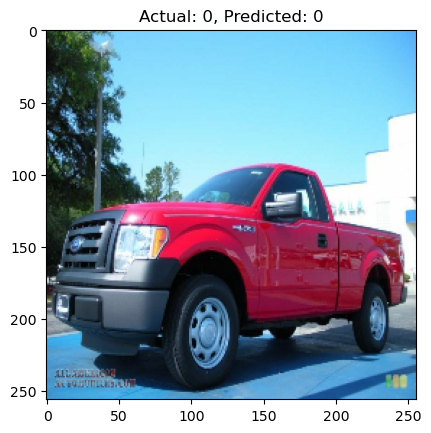

Actual: 0, Predicted: 0


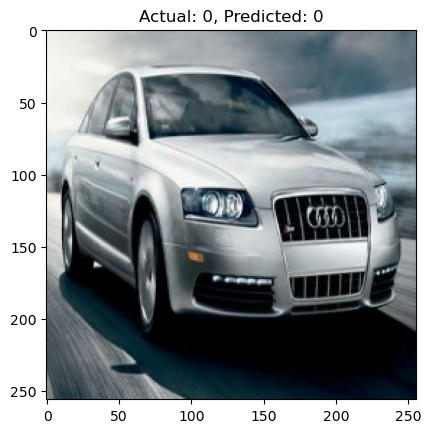

Actual: 1, Predicted: 0


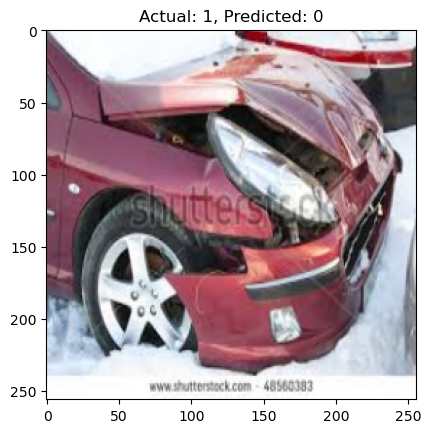

Actual: 1, Predicted: 1


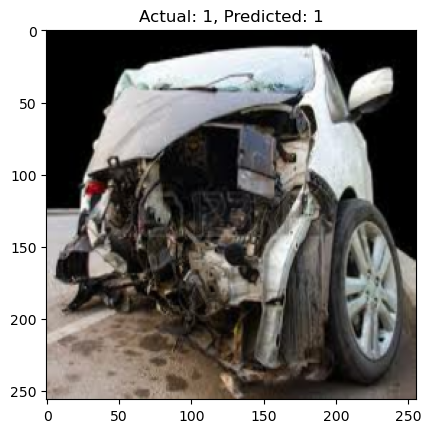

Actual: 0, Predicted: 0


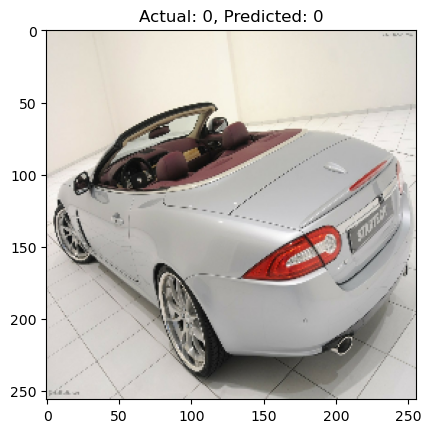

Actual: 0, Predicted: 0


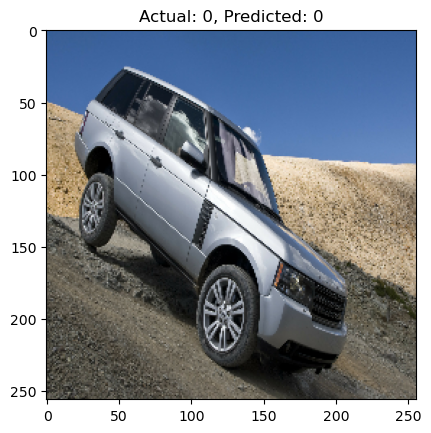

Actual: 0, Predicted: 1


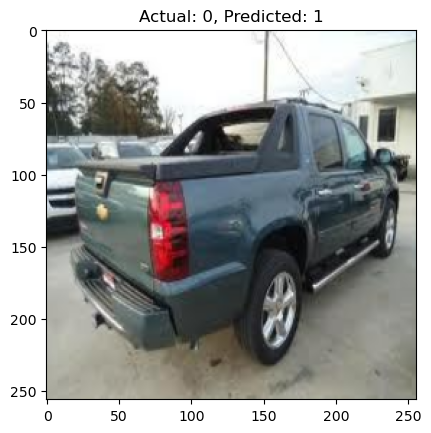

Actual: 0, Predicted: 0


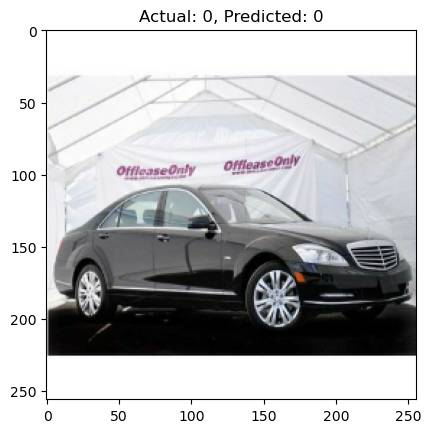

Actual: 1, Predicted: 1


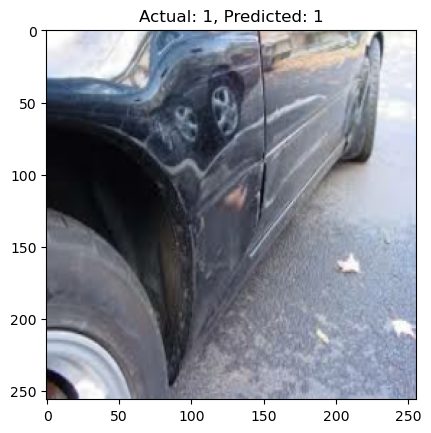

Actual: 0, Predicted: 0


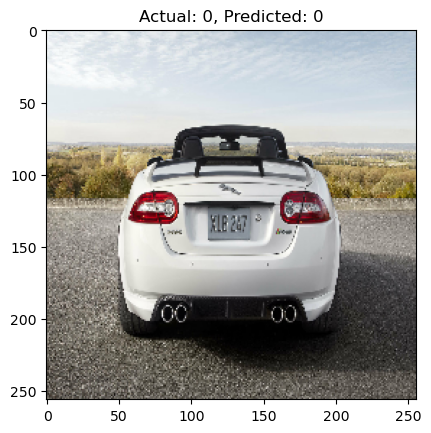

Actual: 0, Predicted: 0


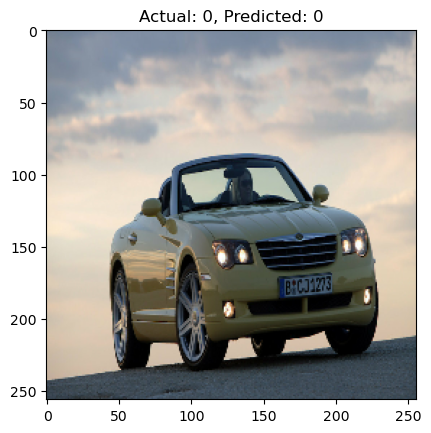

Actual: 0, Predicted: 0


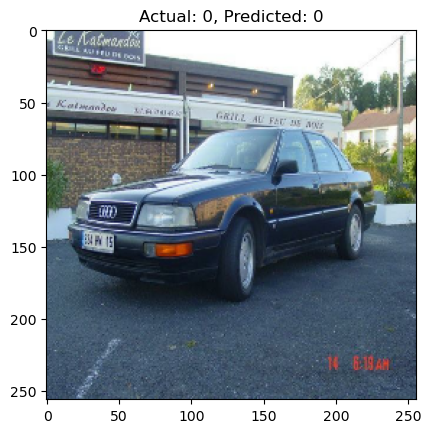

Actual: 0, Predicted: 0


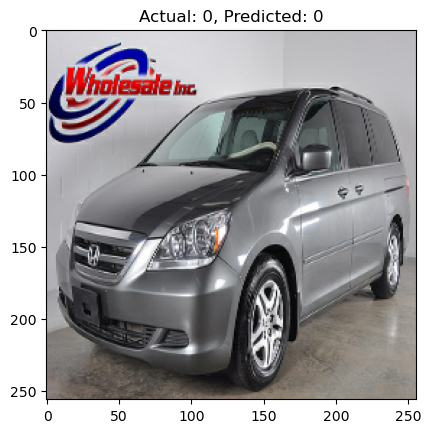

Actual: 0, Predicted: 0


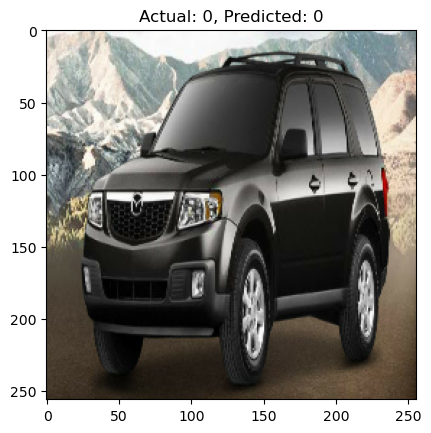

Actual: 0, Predicted: 0


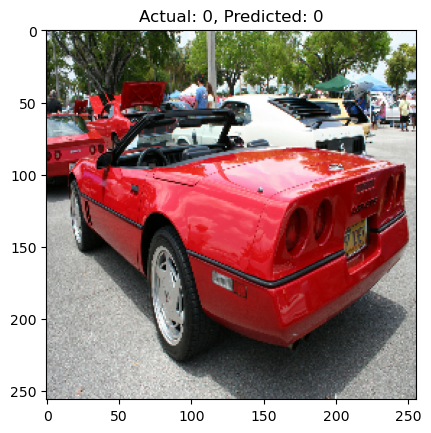

Actual: 0, Predicted: 0


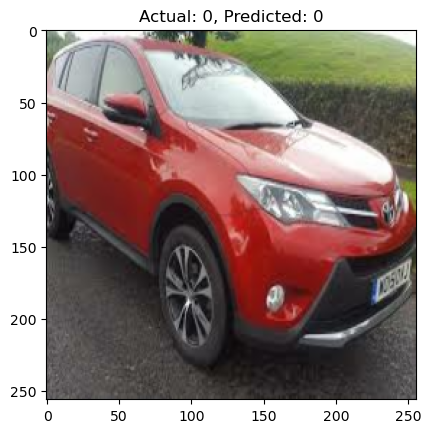

Actual: 0, Predicted: 1


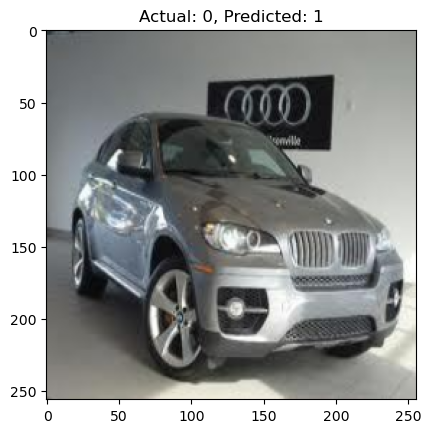

Actual: 0, Predicted: 0


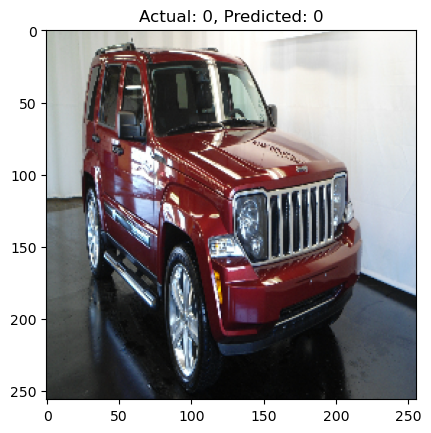

Actual: 1, Predicted: 1


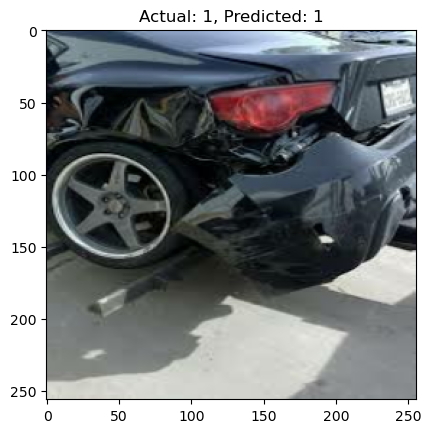

Actual: 1, Predicted: 1


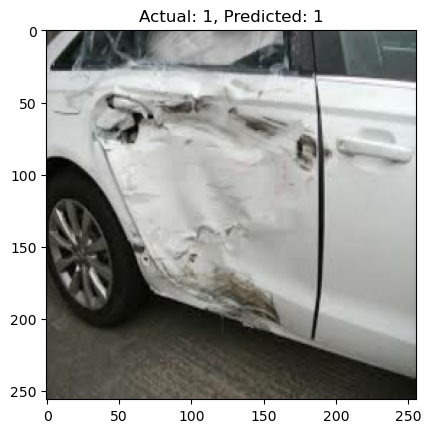

Actual: 0, Predicted: 0


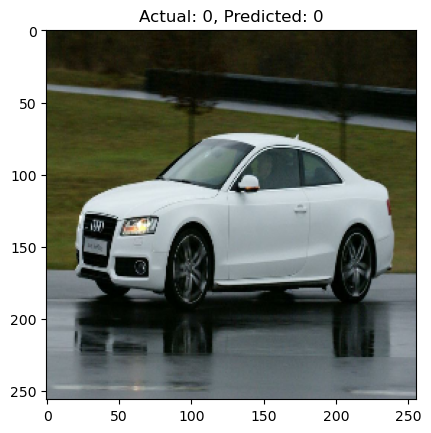

Actual: 1, Predicted: 0


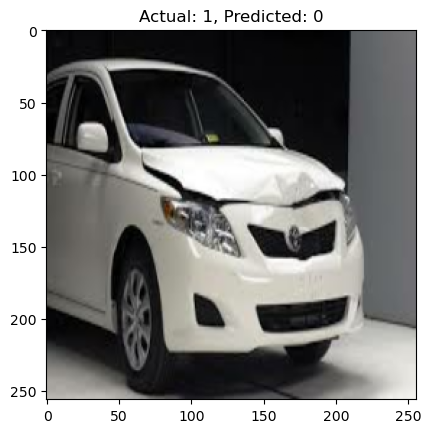

Actual: 0, Predicted: 0


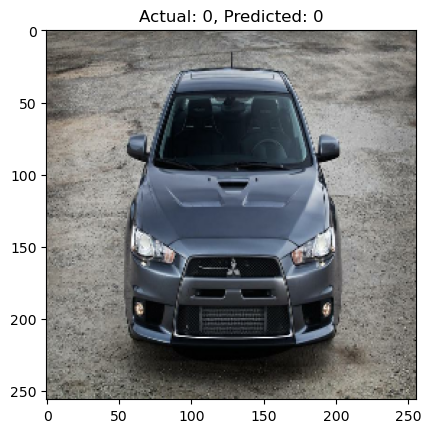

Actual: 0, Predicted: 1


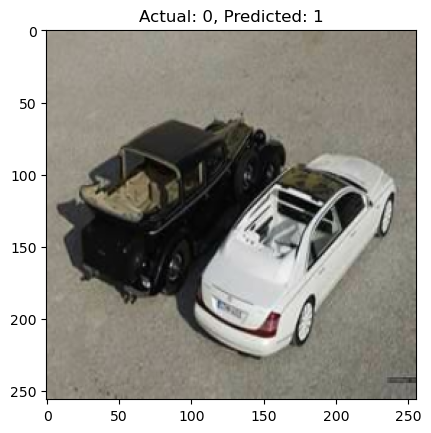

Actual: 0, Predicted: 0


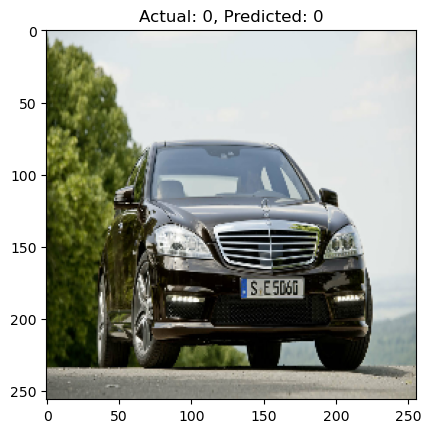

Actual: 0, Predicted: 0


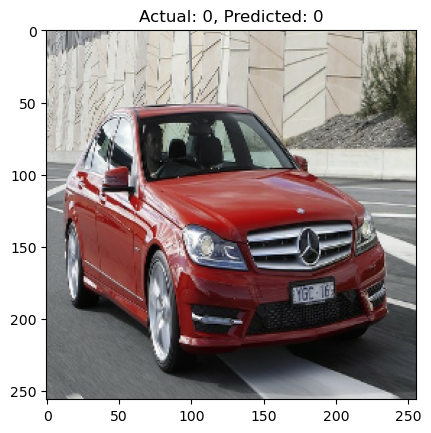

(32,) (32,)
1/1 [==============================] - 0s 63ms/step
Actual: 0, Predicted: 0


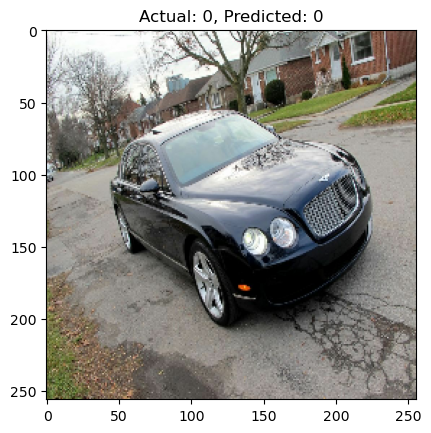

Actual: 0, Predicted: 0


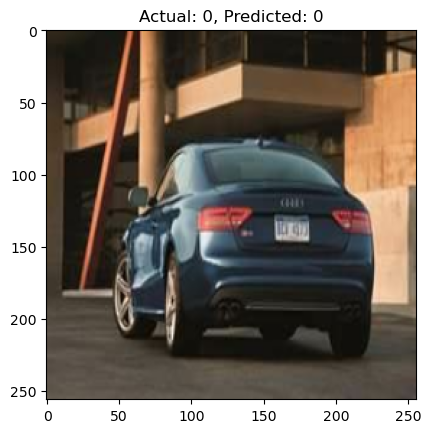

Actual: 0, Predicted: 0


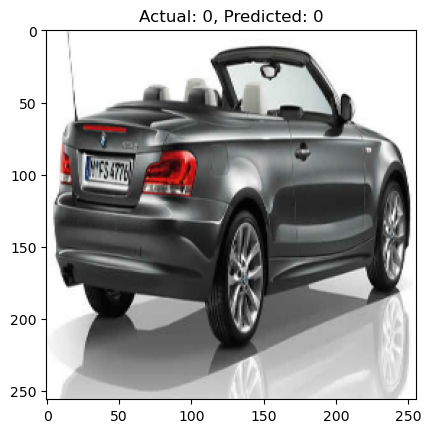

Actual: 0, Predicted: 1


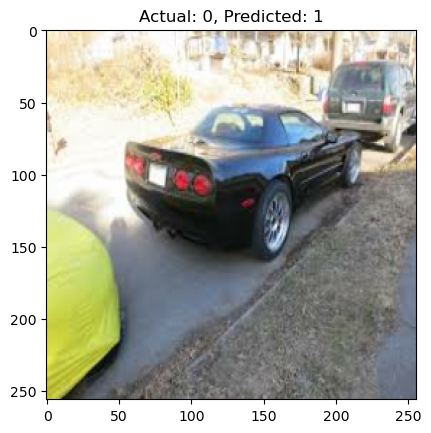

Actual: 0, Predicted: 0


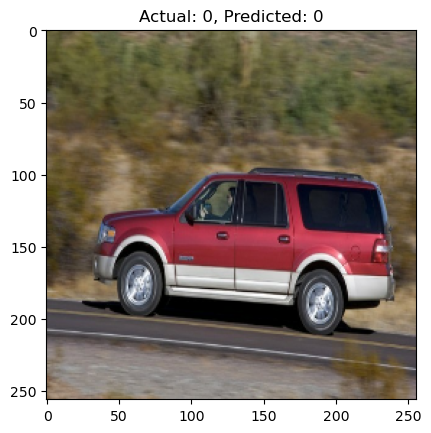

Actual: 1, Predicted: 1


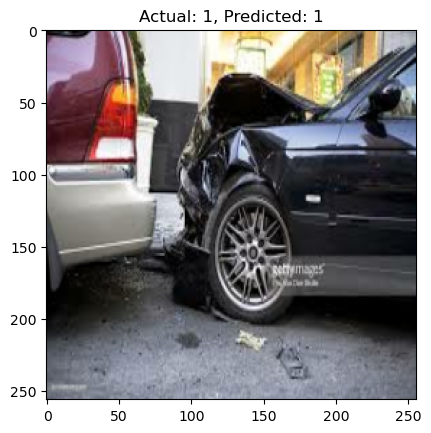

Actual: 0, Predicted: 0


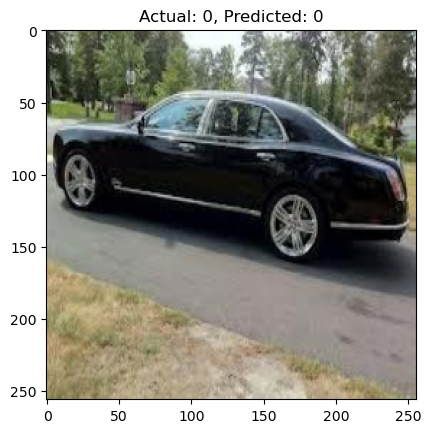

Actual: 1, Predicted: 1


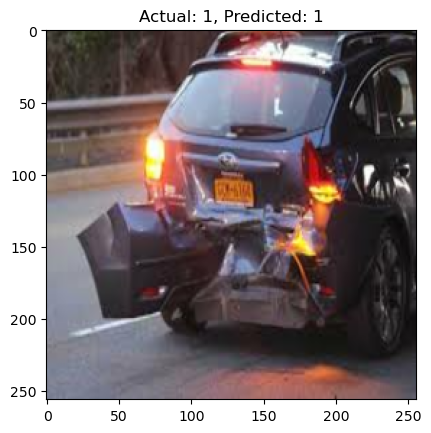

Actual: 1, Predicted: 1


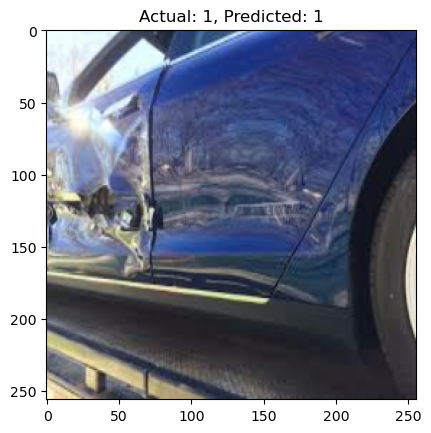

Actual: 1, Predicted: 1


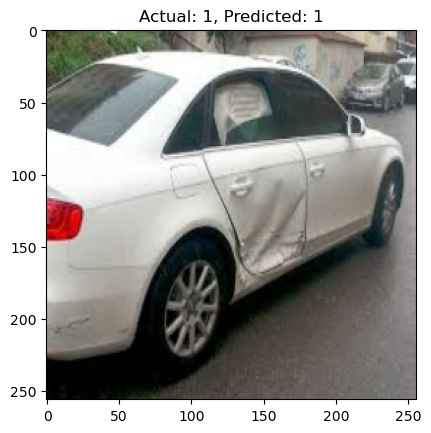

Actual: 0, Predicted: 1


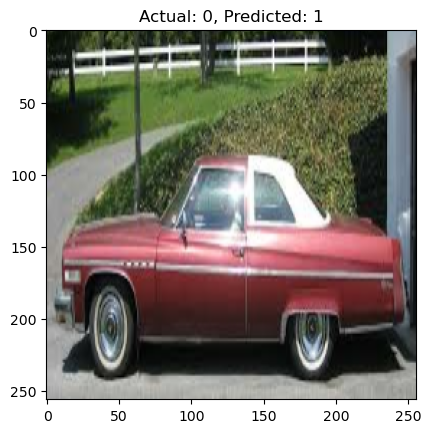

Actual: 0, Predicted: 0


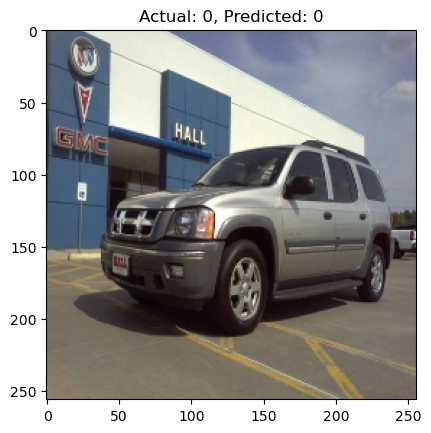

Actual: 1, Predicted: 0


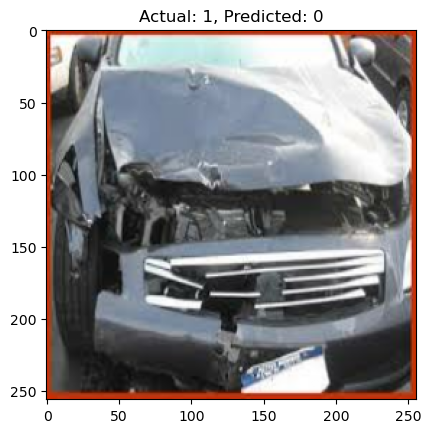

Actual: 1, Predicted: 0


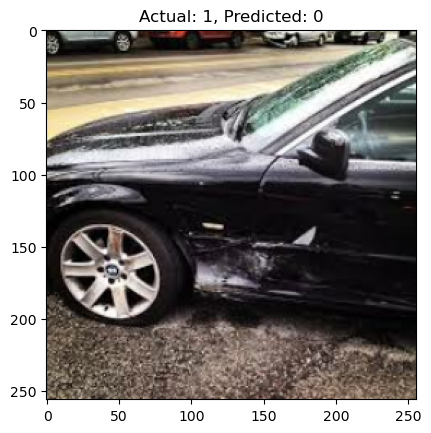

Actual: 1, Predicted: 0


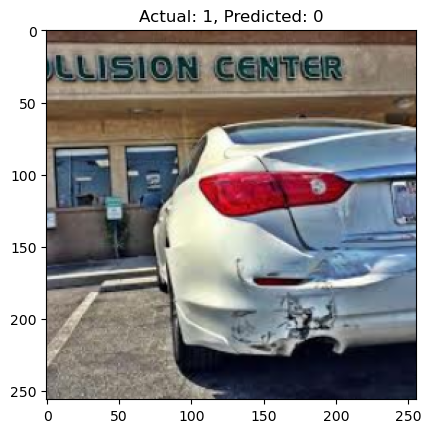

Actual: 1, Predicted: 1


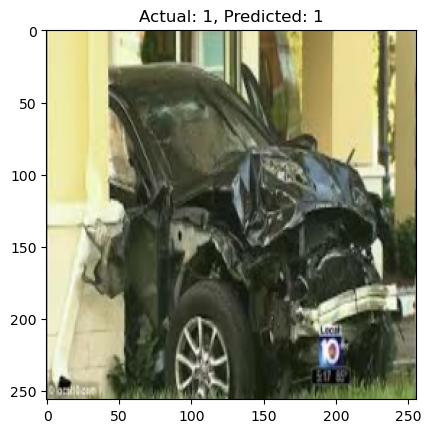

Actual: 1, Predicted: 1


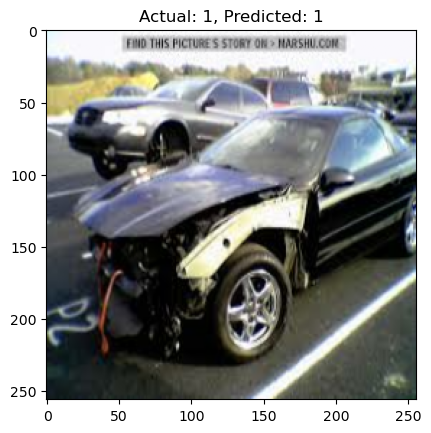

Actual: 1, Predicted: 1


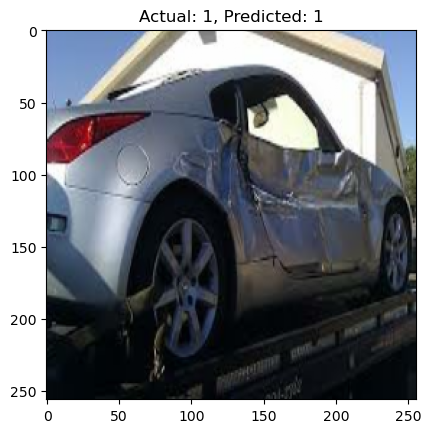

Actual: 1, Predicted: 1


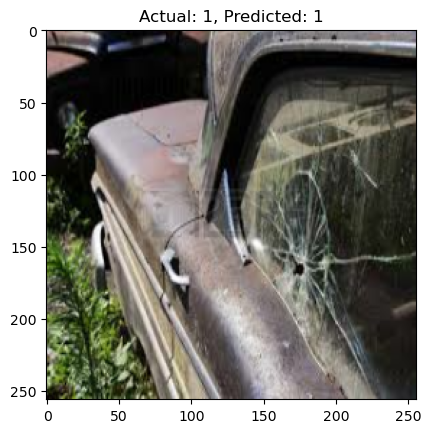

Actual: 0, Predicted: 0


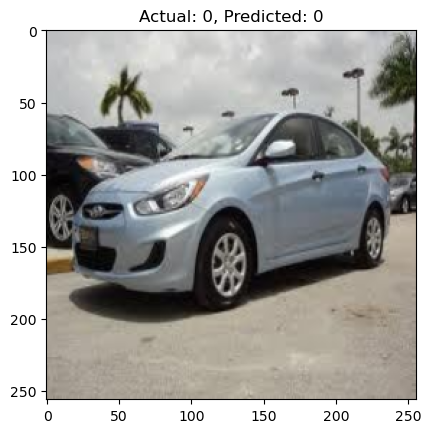

Actual: 0, Predicted: 1


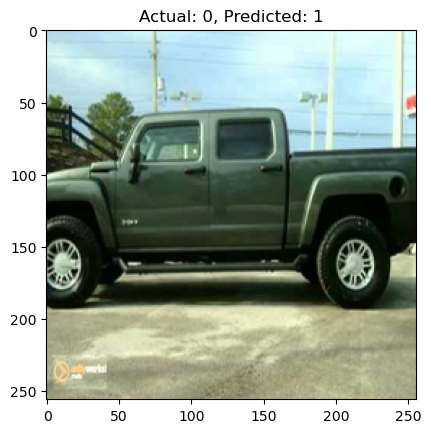

Actual: 0, Predicted: 0


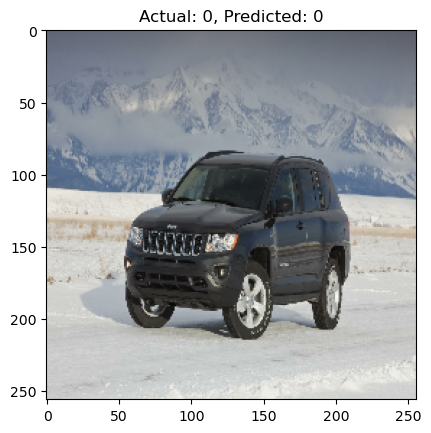

Actual: 0, Predicted: 0


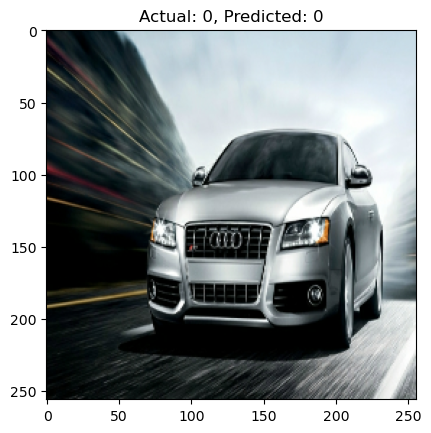

Actual: 1, Predicted: 1


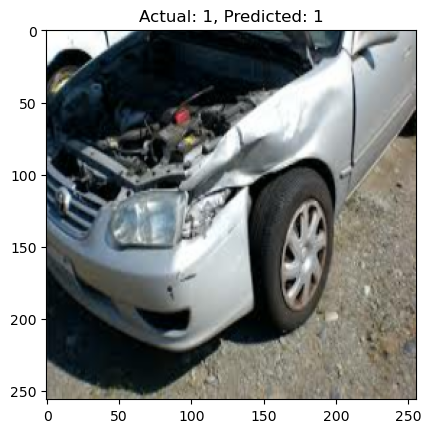

Actual: 0, Predicted: 0


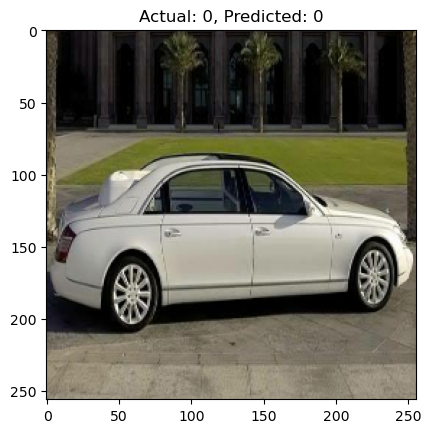

Actual: 1, Predicted: 1


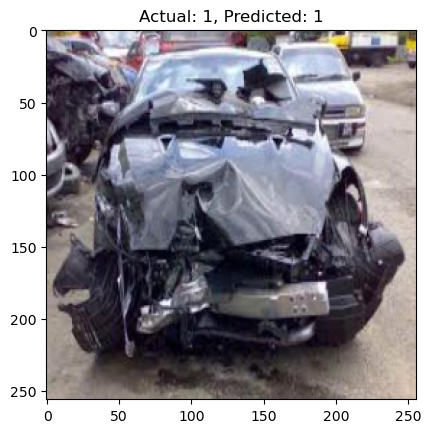

Actual: 0, Predicted: 0


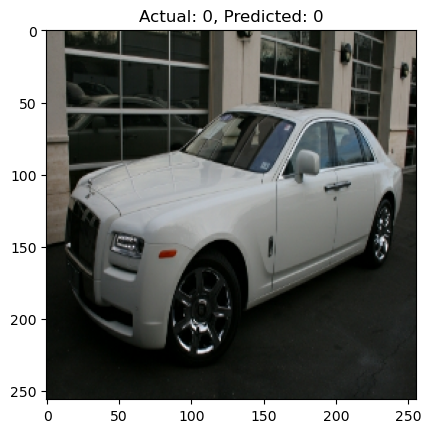

Actual: 0, Predicted: 0


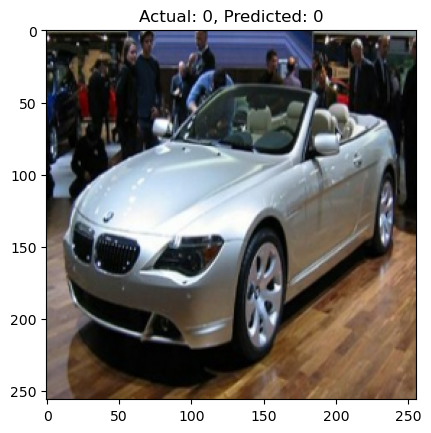

Actual: 1, Predicted: 1


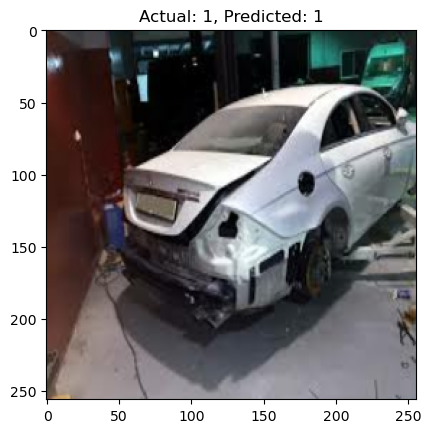

Actual: 1, Predicted: 0


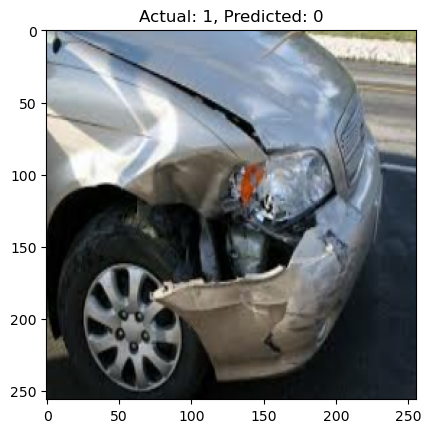

Actual: 0, Predicted: 0


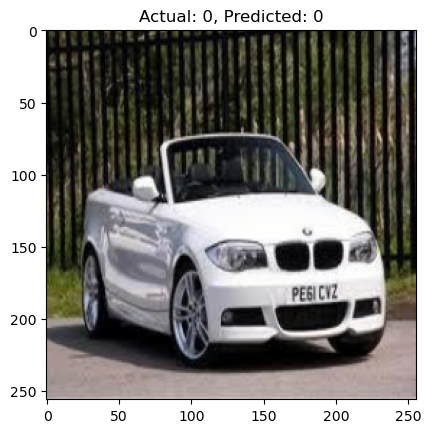

Actual: 1, Predicted: 1


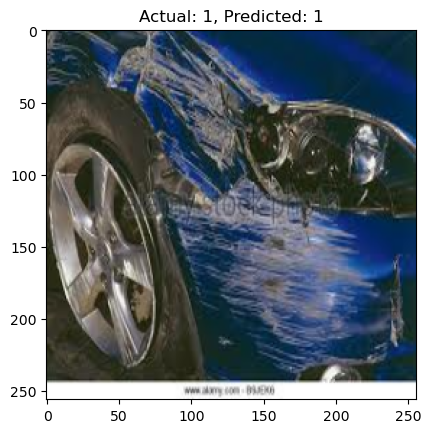

(32,) (32,)
1/1 [==============================] - 0s 61ms/step
Actual: 1, Predicted: 1


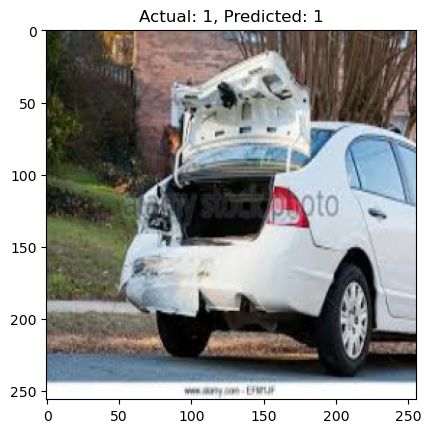

Actual: 0, Predicted: 0


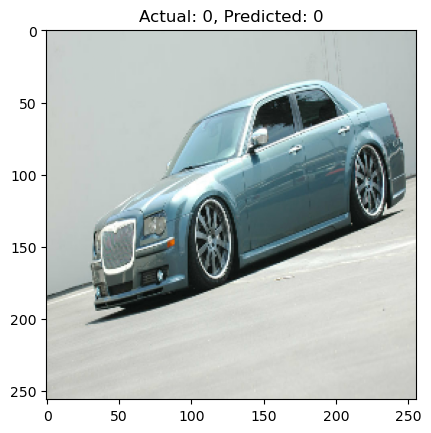

Actual: 0, Predicted: 0


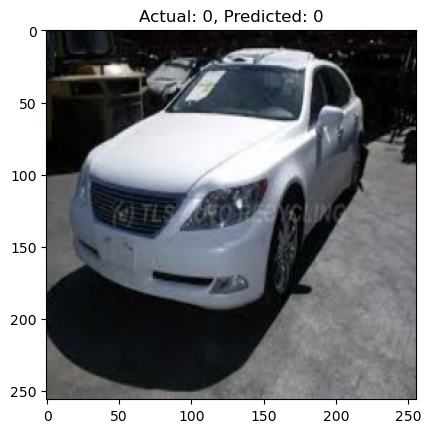

Actual: 1, Predicted: 1


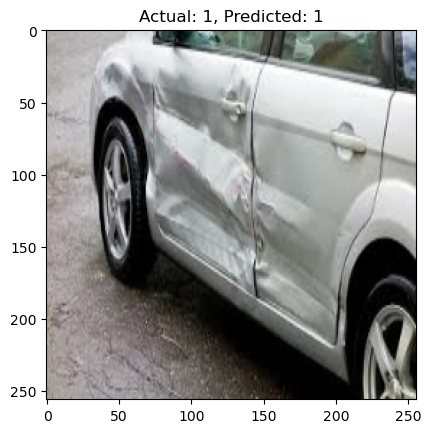

Actual: 0, Predicted: 0


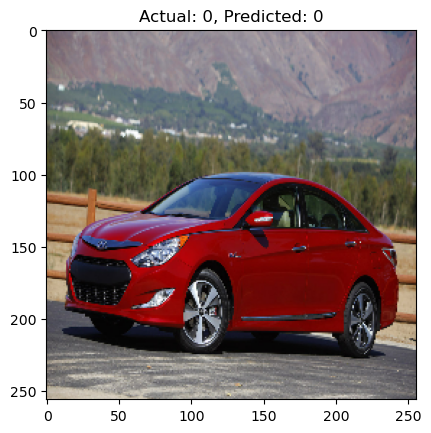

Actual: 0, Predicted: 0


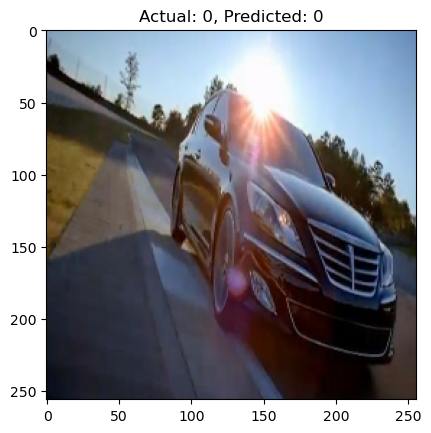

Actual: 1, Predicted: 1


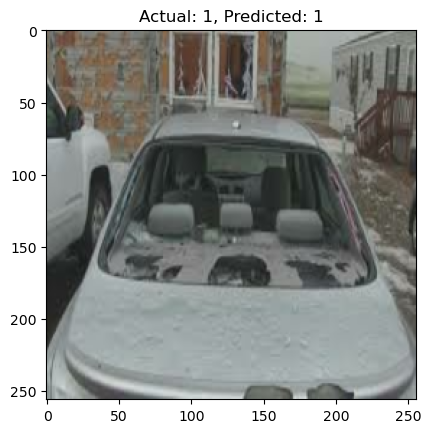

Actual: 0, Predicted: 0


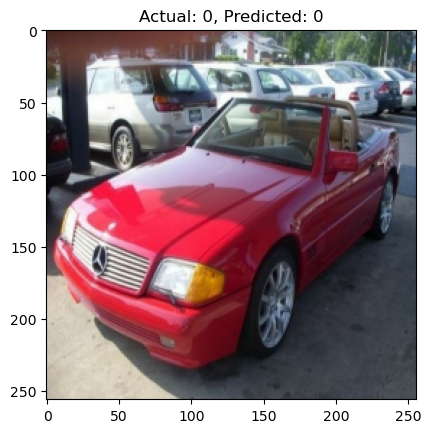

Actual: 0, Predicted: 0


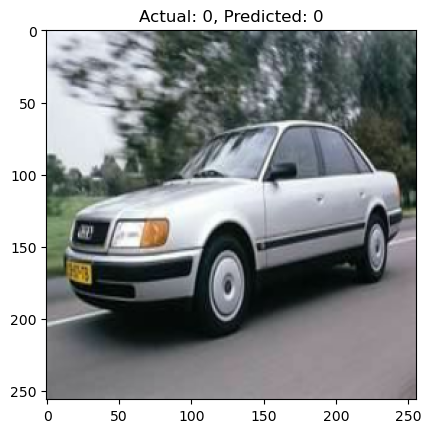

Actual: 0, Predicted: 0


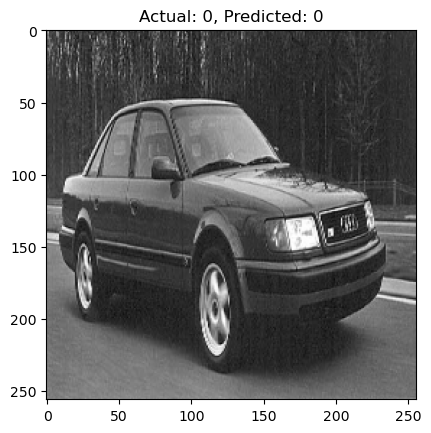

Actual: 1, Predicted: 1


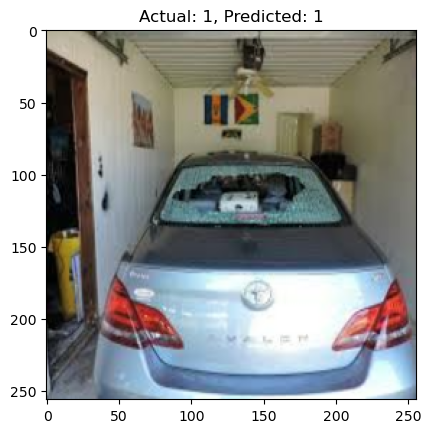

Actual: 0, Predicted: 0


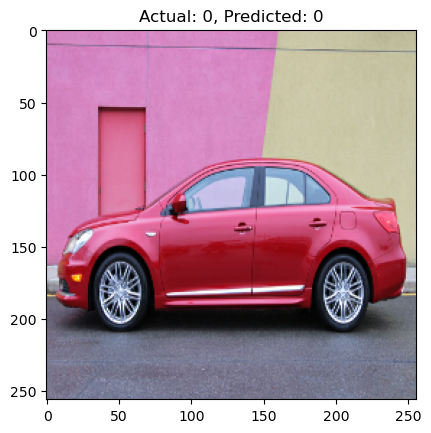

Actual: 0, Predicted: 0


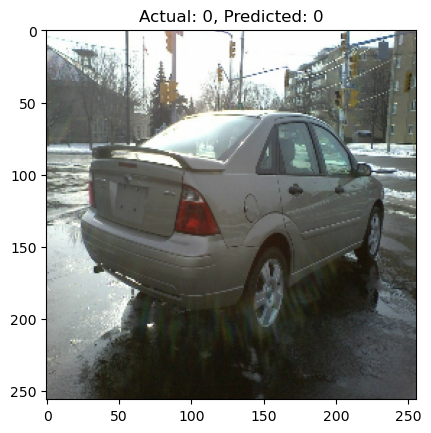

Actual: 1, Predicted: 1


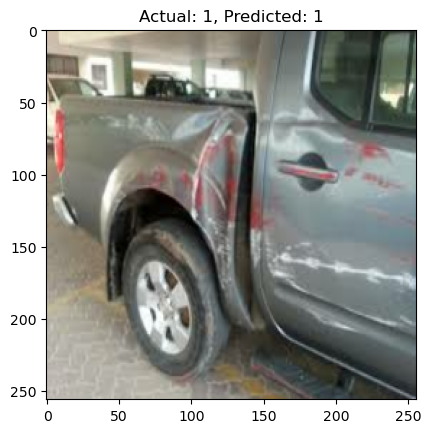

Actual: 1, Predicted: 1


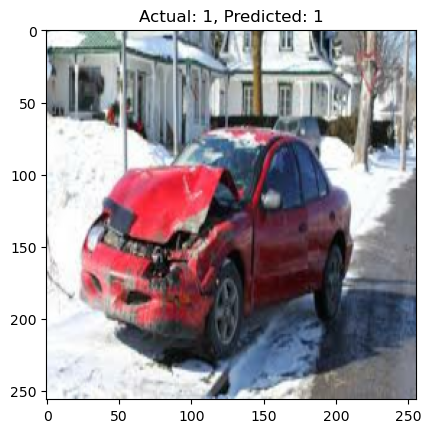

Actual: 1, Predicted: 1


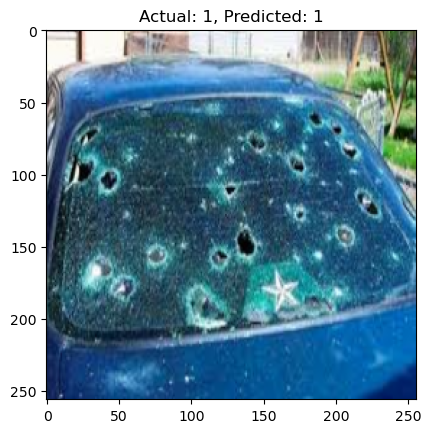

Actual: 1, Predicted: 1


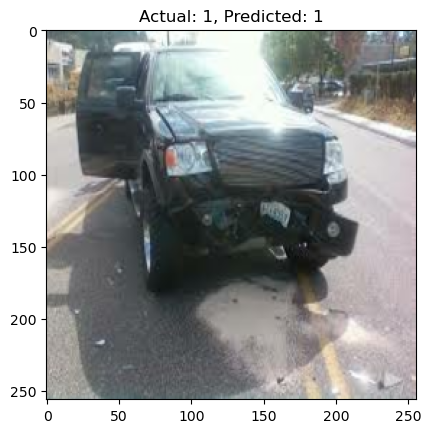

Actual: 1, Predicted: 0


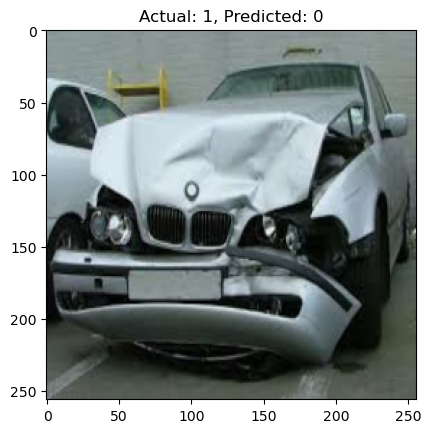

Actual: 1, Predicted: 1


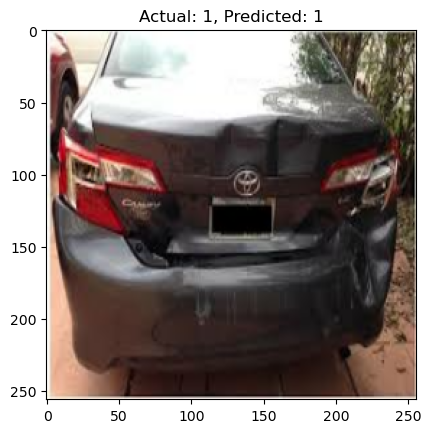

Actual: 0, Predicted: 0


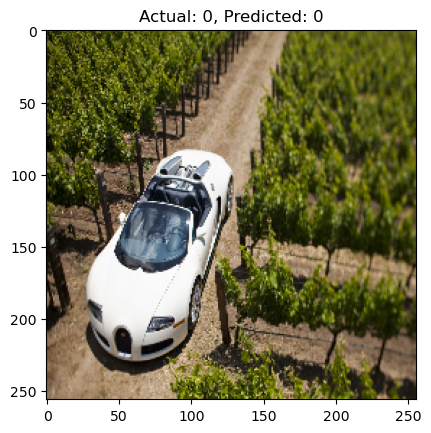

Actual: 0, Predicted: 0


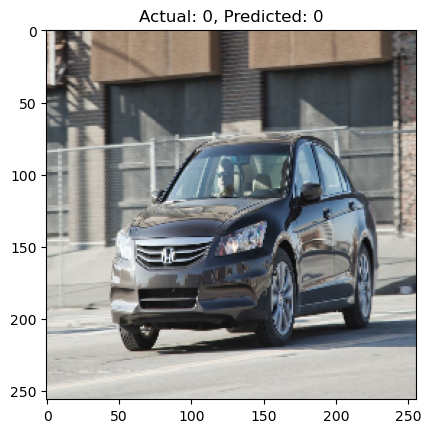

Actual: 0, Predicted: 0


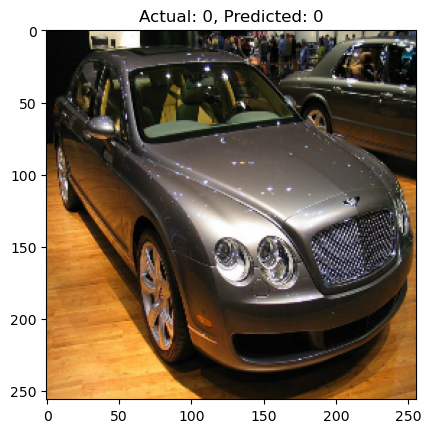

Actual: 0, Predicted: 0


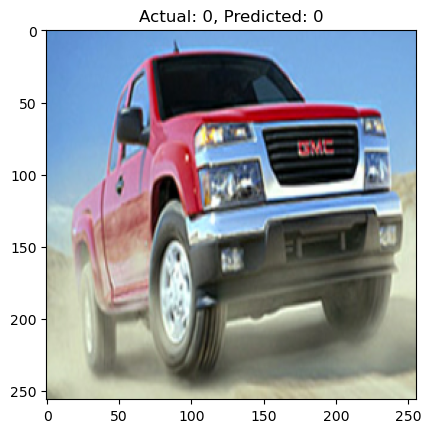

Actual: 0, Predicted: 0


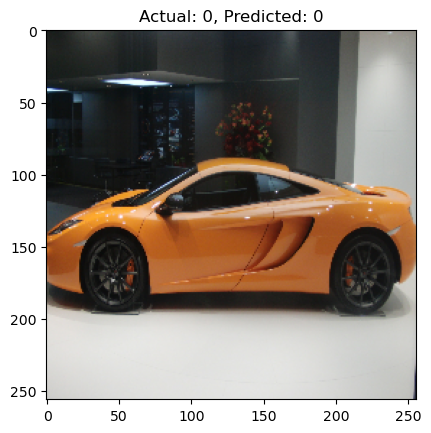

Actual: 1, Predicted: 1


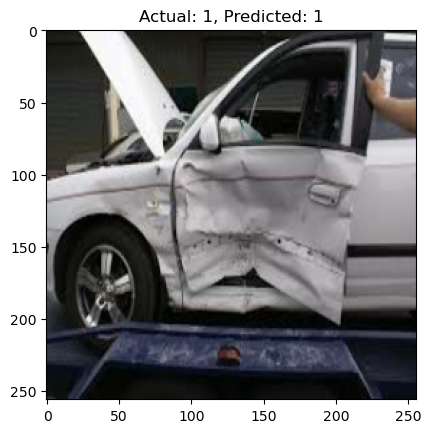

Actual: 0, Predicted: 1


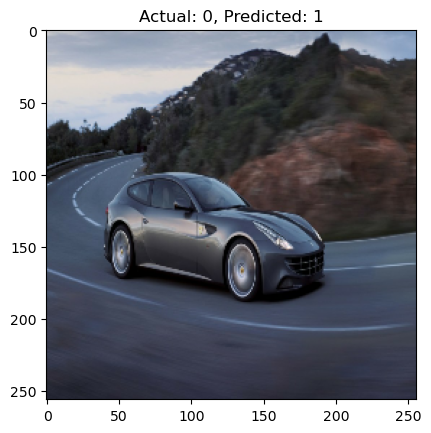

Actual: 1, Predicted: 0


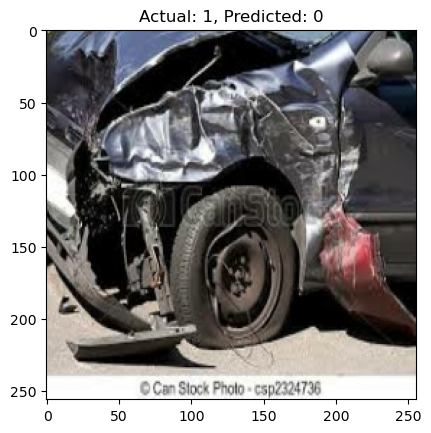

Actual: 0, Predicted: 0


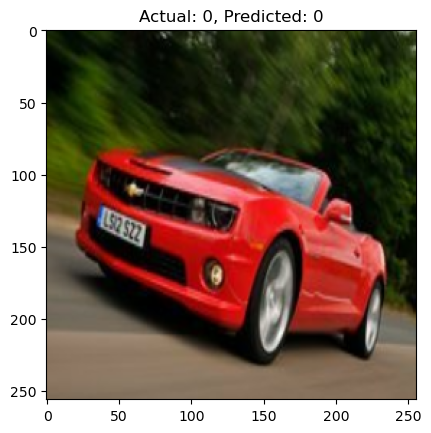

Actual: 1, Predicted: 1


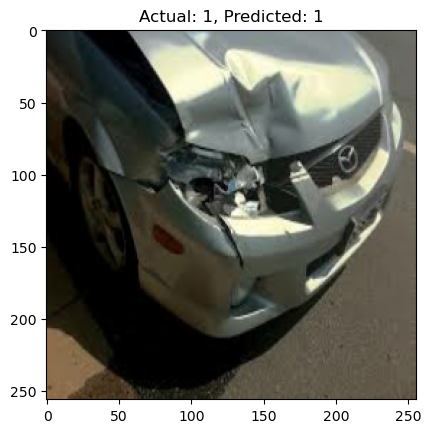

Actual: 1, Predicted: 1


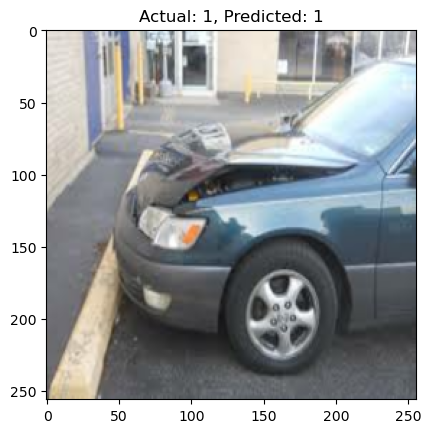

Actual: 0, Predicted: 0


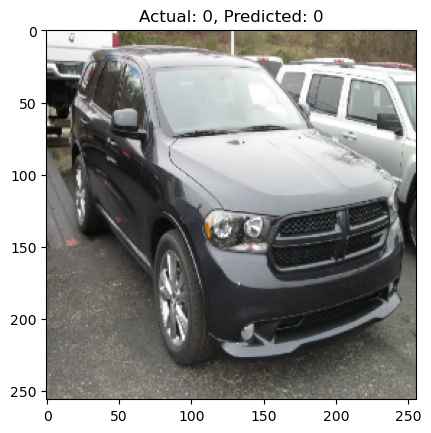

Actual: 0, Predicted: 0


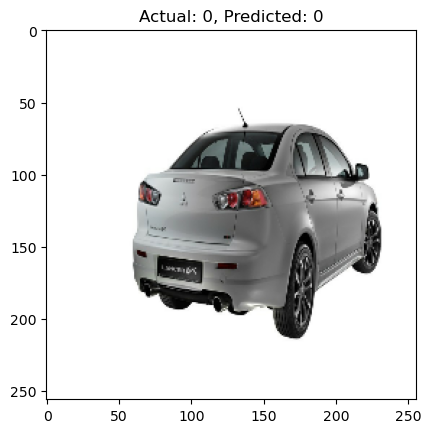

(32,) (32,)
1/1 [==============================] - 0s 82ms/step
Actual: 0, Predicted: 0


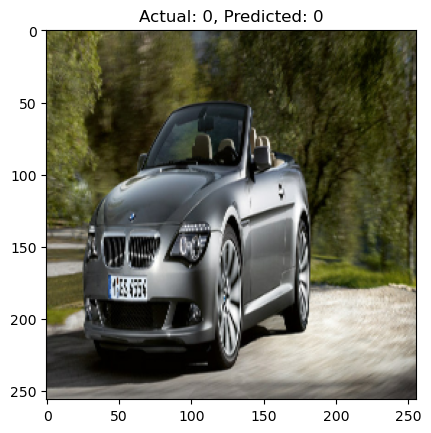

Actual: 0, Predicted: 0


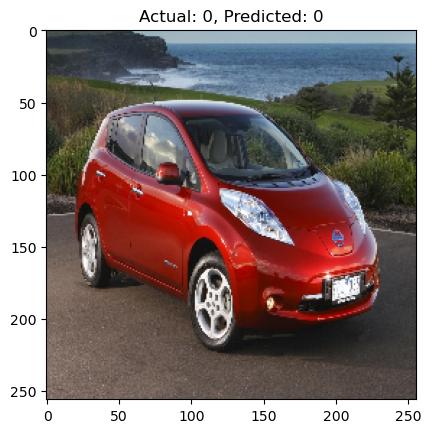

Actual: 1, Predicted: 0


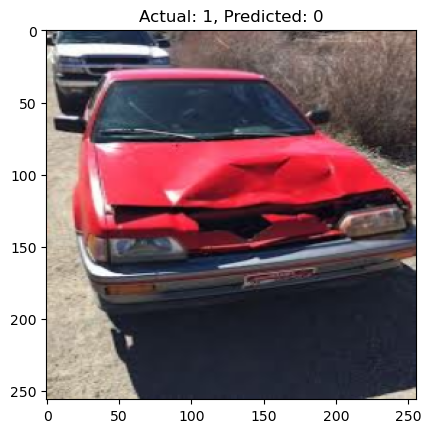

Actual: 0, Predicted: 0


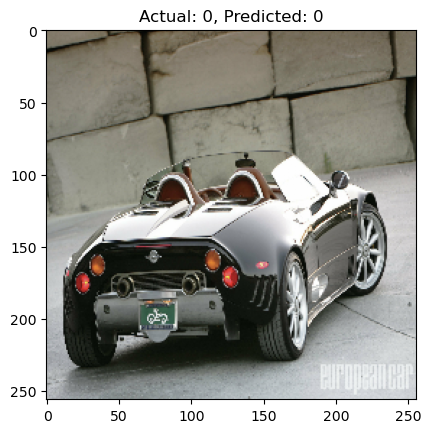

Actual: 1, Predicted: 1


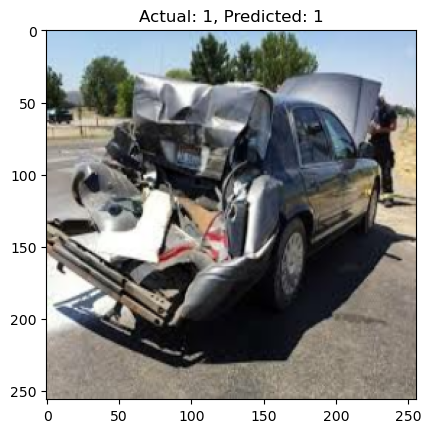

Actual: 0, Predicted: 0


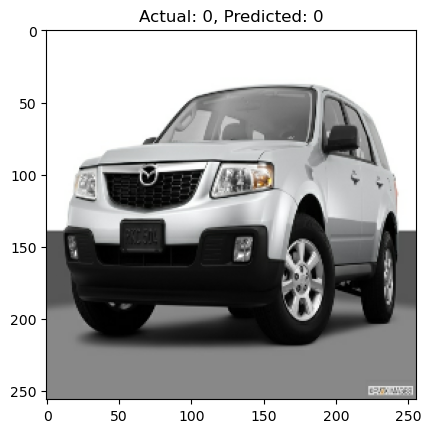

Actual: 0, Predicted: 0


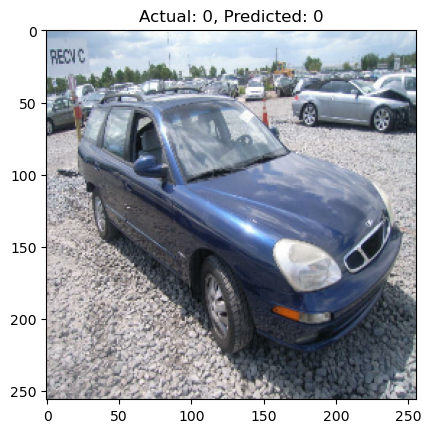

Actual: 1, Predicted: 1


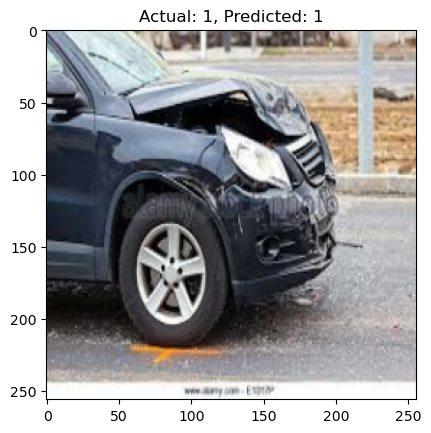

Actual: 0, Predicted: 0


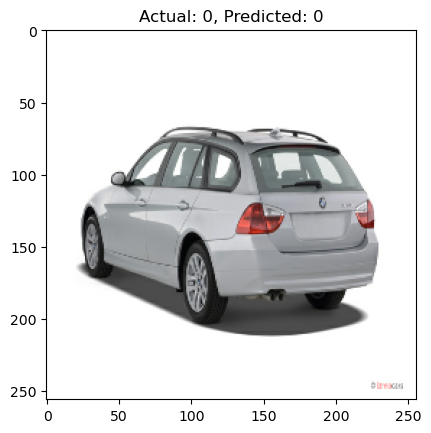

Actual: 0, Predicted: 0


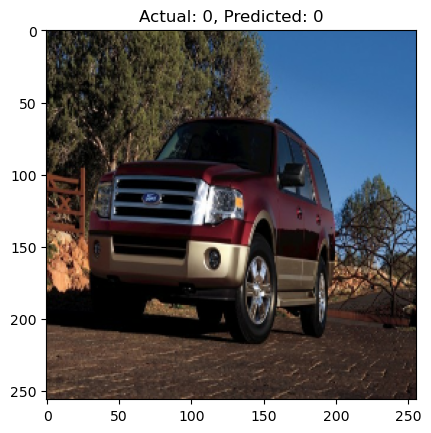

(10,) (10,)


In [31]:


pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for i in range(len(y)):
        actual = y[i]
        predicted = yhat_classes[i]

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        #Display the image
        plt.imshow(X[i])
        plt.title(f"Actual: {actual}, Predicted: {predicted}")
        plt.show()
    print(y.shape,yhat_classes.shape)
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)




In [32]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    # One-hot encode the labels
    y_one_hot = tf.keras.utils.to_categorical(y, num_classes=num_classes)

    for i in range(len(y)):
        actual = y_one_hot[i]
        predicted = tf.one_hot(yhat_classes[i], depth=num_classes)

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        # plt.imshow(X[i])
        # plt.title(f"Actual: {actual}, Predicted: {predicted}")
        # plt.show()

    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y_one_hot, yhat)
    re.update_state(y_one_hot, yhat)
    acc.update_state(y_one_hot, yhat)

pre_result = pre.result().numpy()
re_result = re.result().numpy()
acc_result = acc.result().numpy()

print(f'Precision: {pre_result}, Recall: {re_result}, Accuracy: {acc_result}')


1/1 [==============================] - 0s 54ms/step
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [0. 1.]
Actual: [0. 1.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [1. 0.], Predicted: [1. 0.]
Actual: [0. 

In [33]:
print(f"Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}")

Precision:0.898876428604126, Recall:0.5797101259231567, Accuracy:0.8333333134651184


Test

In [34]:
import cv2

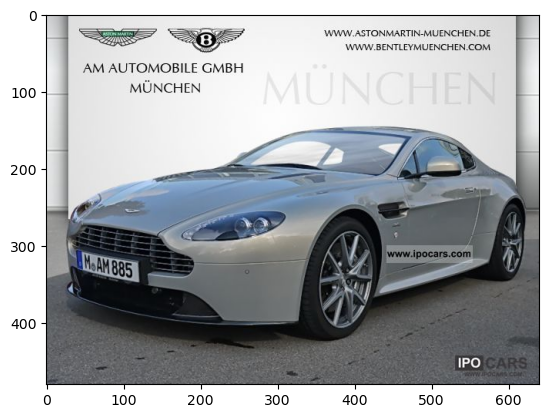

In [35]:
img=cv2.imread('test_image_0.jpg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

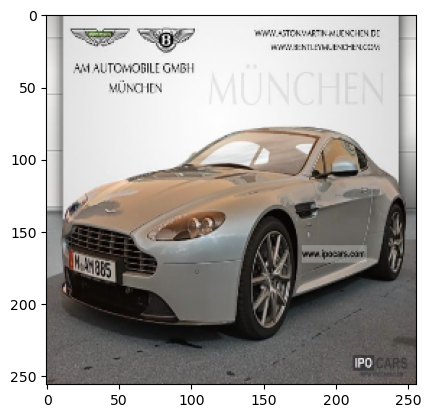

In [36]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [37]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 [==============================] - 0s 237ms/step


In [38]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 0


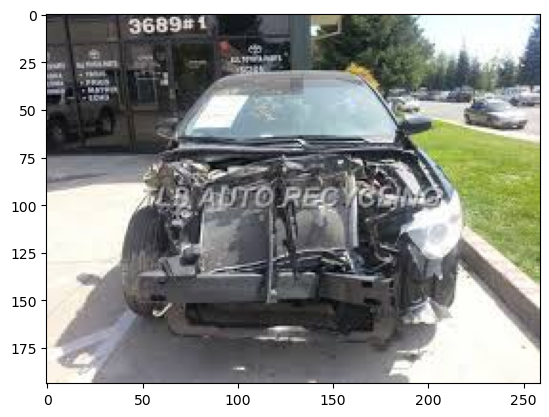

In [39]:
img=cv2.imread('test_image_1.jpeg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

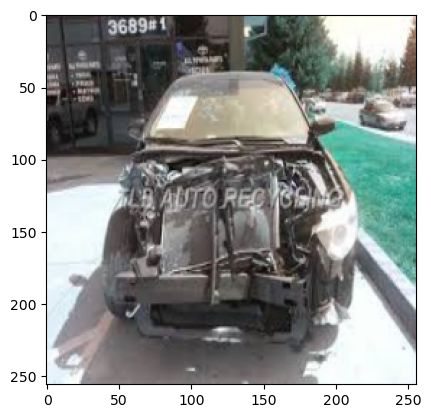

In [40]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [41]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 [==============================] - 0s 25ms/step


In [42]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 1


In [43]:
###########################################

In [44]:
###########################################

In [45]:
%pip install uvicorn gunicorn fastapi pydantic

In [46]:
%pip list

Package                           Version
--------------------------------- ------------
absl-py                           2.1.0
aiobotocore                       2.7.0
aiohttp                           3.9.3
aioitertools                      0.7.1
aiosignal                         1.2.0
alabaster                         0.7.12
altair                            5.0.1
annotated-types                   0.6.0
anyio                             4.2.0
appdirs                           1.4.4
argon2-cffi                       21.3.0
argon2-cffi-bindings              21.2.0
arrow                             1.2.3
astroid                           2.14.2
astropy                           5.1
asttokens                         2.0.5
astunparse                        1.6.3
async-lru                         2.0.4
async-timeout                     4.0.3
atomicwrites                      1.4.0
attrs                             23.1.0
Automat                           20.2.0
autopep8                   

In [47]:
# Define the path where you want to save the model
model_path = "../DEPLOY_MODEL1/model1.h5"

# Save the model to the specified path
model.save(model_path)


In [48]:
# # Define the path where you want to save the model
# model_path = "../DEPLOY_MODEL1/model1.h5"

# # Save the model to the specified path
# model.save(model_path)